In [1]:
#-*- coding:utf-8 -*-

"""
Created on Saturday, August 20th, 2022 (15:30)
Author: @Allen M. Y. He*; @Y. Jin
Copyright (C) 2022: Zexian Zeng laboratory
Academy for Advanced Interdisciplinary Studies
Center for Life Sciences & Center for Quantitative Biology
Peking University

1. Quick run on the following python interpreter:
"/home/heyf/miniconda3/envs/Ryf/bin/python",
or you can install independencies in your environment.

2. Up to now, two modules are included:
(i)   Single cell RNA sequencing analysis based on Scanpy and Diffxpy
(ii)  Single cell TCR/BCR sequencing analysis based on Scirpy
"""

import os
from pickle import FALSE
import re
import math
from tkinter.tix import Tree
import igraph
import openpyxl
import warnings
import scipy as sp
import numpy as np
import pandas as pd
import scanpy as sc
import scirpy as ir
import scvelo as scv
import seaborn as sns
import scrublet as scr
import harmonypy as hm
from typing import Dict
from ctypes import Union
from pandas import DataFrame
from typing import List, Dict
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib.pyplot import rc_context

print(
    "Read this instruction before you use: \n",
    " 1. You need to module load miniconda3, and activate the virtual environment scrna \n",
    " 2. Run the folloing code: \n",
    "import sys \n",
    "sys.path.append(\"/home/heyf/pipeline/\") \n",
    "import pipeline2 \n",
    " Then you can use pipeline2.pipeline() function to run pipeline \n",
    " Important input parameters are as followed: \n",
    " a. data --- A dictionary with sample names as keys, and lists containing scRNA-seq matrix (position 0) and TCR-seq csv file (position1, optional) as values \n",
    " b. rna --- Bool, Whether to include RNA-seq data, default: True \n",
    " c. tcr --- Bool, Whether to include TCR/BCR-seq data, default: False \n", 
    " d. results_file --- string, path to output dir, default: os.getcwd() \n", 
    " e. exp_type --- string, Samples type (i.e., control, k.o.), default: Control\n", 
    " f. marker --- dictionary, with cell type as keys and marker gene as values, default is a commonly used marker gene list. If you have no specific requirements, just ignore this please. \n",
    " g. cluster_method --- string, louvain or leiden, default: louvain \n",
    " h. min_cell, used in TCR-seq analysis. Setting to 3~5 is recommended, but if you get erros, just lower the number (i.e., 1~2). Its meaning is referred to Scirpy API. \n"
    " 3. Only run scRNA-seq analysis pipeline, you need to note that: \n",
    " 3.1 data = { \"sample_1\": [\"dir_to_matrix/\"], \"sample_2\": [\"dir_to_matrix/\"], ...} \n",
    " 3.2 tcr=False",
    " 4. Run scRNA-seq data with TCR/BCR-seq data: \n",
    " 4.1 data = { \"sample_1\": [\"dir_to_matrix/\", \"dir_to_csv/filtered_contig_annotations.csv\"], \"sample_2\": [\"dir_to_matrix/\", \"dir_to_csv/filtered_contig_annotations.csv\"], ...} \n",
    " 4.2 tcr=False \n",
    " 4.3 min_cell is recommended to apply 3~5. if you get an erro, please try lower min_cell, i.e. min_cell=1. \n",
    " 4.4 Only support Cellranger output. To support TRUST4 output, I may need additional helpers. (Functional code is finished, but I still need helpers to solve the compatibility of this pipeline)\n"
)

marker = {
    'CD4 naive T': ['CD4', 'LTB', 'CCR7', 'IL7R', 'SELL', 'LEF1', "TCF7"],
    'CD4 CTL': ['GNLY', 'GZMB', 'TRGV9', 'PRF1'],
    'Th1': ['TBX21', 'CXCR3'],
    'Th17': ['CCR6'],
    'Th2' : ['GATA3', 'CCR3'],
    'Treg': ['FOXP3'],
    'CD8 naïve T': ['CD8A', 'CCR7', 'IL7R', 'SELL', 'LEF1'],
    'GZMK CD8': ['CD8A', 'GZMK'],
    'MAIT': ['SLC4A10', 'TRAV1-2','KLRB1'],
    'CD8 cytotoxic T': ['CD8A', 'GNLY', 'KLRG1', 'GZMB', 'PRF1'],
    'γδ T': ['TRGV9', 'TRDC'],
    'Exhaustion related genes': ['LAG3', 'PDCD1', 'LAYN', 'HAVCR2', 'CTLA4', 'GGT1', 'TIGIT', 'CD160'],
    'Exhaustion related TF': ['TOX', 'PRDM1', 'SOCS1', 'EOMES', 'TBX21', 'BATF', 'FOXO1'],
    'Macrophages': ['CD163', 'CD68'],
    'Monocytes': ['CD14', 'ITGAM', 'FCGR3A', 'FCGR3B'],
    'Mono_Macro': ["CD14","CCR2","CD68",'ARG1',"ADGRE1"],
    'Dendritic cells': ['CLEC9A', 'CD1C', 'CLEC10A'],
    'Dendritic': ["CD1C","CD209","CCL22","CD86"],
    'T cell': ['CD3D', 'CD3G', 'PTPRC'],
    'NK cell': ['KLRD1', 'MRPL47', 'NCR1'],
    'NK': ["KLRK1", "KLRC1", "KLRF1"],
    'Myeloid': ['CD14', 'CD33', 'CD68', 'ITGAM', 'ITGAX'],
    'B cell': ['CD19', 'TNFRSF17', "CD79A", "CD79B"],
    'CD4_Treg': ["FOXP3"],
    'CD4conv': ["CD4","CD3E","CD3D"],
    'Neutrophils': ["S100A9", "MPO", "CXCR2"],
    'Mast': ["CPA3", "ENPP3"],
    'Plasma': ["SLAMF7", "IGKC"],
    'HSC': ["CD34","KIT"],
    'Epithelial': ["EPCAM"],
    'Endo': ["VWF","PECAM1"],
    'Fibro': ["COL1A2","MMP2","MYL9"]
}

# scanpy settings
run_alignment = True
sc.settings.verbosity = 3
sc.logging.print_header()
sc.set_figure_params(fontsize=10)
sc.settings._vector_friendly = True
plt.rcParams['figure.figsize'] = (15.0, 15.0)
warnings.filterwarnings('ignore', category=FutureWarning)
sc.settings.set_figure_params(dpi=80, facecolor='white')

def pipeline(
    data = None, # Key: Sample name; Item: matrix directory or [RNA mtx, tcr csv]
    sample = None, # sample name list
    matrix = None, # matrix directory list (match with sample names)
    rna = True, # whether to include RNA analysis
    tcr = False, # whether to include TCR analysis
    tcr_data = None, # TCR file list: filtered_contig_annotation.csv
    results_file:str = os.getcwd(), # self-defined
    exp_type:str = "Control", # self-defined
    marker = marker, # self-defined
    cluster_method = "louvain", # leiden or louvain (Louvain is recommended)
    min_cell = 2
    ):
    # check input
    file_dic = {}
    if rna == True:
        if (data != None):
            sample = [i for i in data.keys()]
            matrix = [i if isinstance(i,str) else i for i in data.values()]
        if (tcr == False) and (len(sample) == len(matrix)):
            file_dic = dict(zip(sample, matrix))
        elif (tcr == True) and (tcr_data == None):
            if len(sample) != len(matrix):
                raise ValueError("Please inspect your input length.")
            if isinstance(matrix[0], str):
                raise ValueError("Please inspect your input length.")
            else:
                file_dic = dict(zip(sample, matrix))
        elif (tcr == True) and (tcr_data != None):
            if (len(sample) == len(matrix)) and (len(matrix) == len(tcr_data)):
                file_dic = dict(zip(sample, list(zip(matrix, tcr_data))))
            else:
                raise ValueError("Please inspect your input length.")
        else:
            raise ValueError("Please inspect your input data.")
    elif tcr == True:
        if (data != None):
            sample = [i for i in data.keys()]
            matrix = [["none", i] if isinstance(i,str) else ["none", i[0]] for i in data.values()]
            file_dic = dict(zip(sample, matrix))
        elif (tcr_data != None) and (sample != None):
            if (len(tcr_data) == len(sample)):
                matrix = [["none", i] for i in tcr_data]
                file_dic = dict(zip(sample, matrix))
            else:
                raise ValueError("Please inspect your input data.")
        else:
            raise ValueError("Please inspect your input data.")
    else:
        raise ValueError("Please inspect your input parameters.")
    # Create output file "./figures"
    stat = {}
    adata_dic = []
    adata_out = []
    results_file = os.path.join(results_file, "figures")
    if os.path.exists(results_file) == False:
        os.mkdir(results_file)

    # Read data
    if rna == True:
        for i in file_dic.keys():
            figid = 1
            patient_id = i
            sc.set_figure_params(fontsize=10)
            adata = sc.read_10x_mtx(
                path = file_dic[i][0], var_names = 'gene_symbols', make_unique = True
                )
            adata.var_names_make_unique()
            adata.raw = adata
            if tcr == True:
                vdj = ir.io.read_10x_vdj(file_dic[i][1])
                ir.pp.merge_with_ir(adata, vdj)
            
            # Quality control
            adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
            sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

            # Fig 1. Three violin plots
            fig, axes = plt.subplots(1,3, figsize = (25,8))
            plt.suptitle("Patient " + patient_id, verticalalignment = 'top', horizontalalignment = 'center', fontsize=25)
            sc.pl.violin(adata, 'n_genes_by_counts', jitter=0.4, show=False, ax=axes[0])
            sc.pl.violin(adata, 'total_counts', jitter=0.4, show=False, ax=axes[1])
            sc.pl.violin(adata, 'pct_counts_mt', jitter=0.4, show=False, ax=axes[2])
            savefig(results_file, figid, "violin_preQC", exp_type, patients = patient_id)
            figid += 1

            # Fig 2. Total vs genes
            total_vs_genes = sns.jointplot(
                data=adata.obs,
                x="total_counts",
                y="n_genes_by_counts",
                kind="scatter",
                palette="blue"
            )
            plt.title("Patient " + patient_id, verticalalignment = 'bottom', horizontalalignment = 'left')
            savefig(results_file, figid, "total_vs_genes", exp_type, patients = patient_id)
            figid += 1

            # Fig 3. Total vs mito.percentage
            total_vs_mtcounts = sns.jointplot(
                data=adata.obs,
                x="total_counts",
                y="pct_counts_mt",
                kind="scatter",
                palette="blue"
            )
            plt.title("Patient " + patient_id, verticalalignment = 'bottom', horizontalalignment = 'left')
            savefig(results_file, figid, "total_vs_mitocounts", exp_type, patients = patient_id)
            figid += 1
            
            # Doublet
            counts_matrix = adata.X
            scrub = scr.Scrublet(counts_matrix, expected_doublet_rate=0.1, sim_doublet_ratio=3)
            scrub.call_doublets()
            doublet_scores, predicted_doublets = scrub.scrub_doublets(n_prin_comps=50)

            # Fig4: Doublet his
            scrub.plot_histogram()
            plt.suptitle("Patient " + patient_id, y = 0.999, x=0.55)
            savefig(results_file, figid, "doublet_his", exp_type, patients = patient_id)
            figid += 1
            
            # Fig5: Doublet UMAP
            scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.3))
            scrub.plot_embedding('UMAP', order_points=True)
            plt.suptitle("Patient " + patient_id, y = 0.999, x=0.55)
            savefig(results_file, figid, "doublet_umap", exp_type, patients = patient_id)
            figid += 1
                
            total_counts= (adata.obs.total_counts >= 2000) & (adata.obs.total_counts <= 100000)
            mt_outlier = (adata.obs.pct_counts_mt <= 10)
            doublets = (predicted_doublets==False)

            stat[i] = {
                "max_total_counts": max(adata.obs["total_counts"]), "min_total_counts": min(adata.obs["total_counts"]),
                "mean_total_counts": np.mean(adata.obs["total_counts"]), "medium_total_counts": np.median(adata.obs["total_counts"]),
                "max_features": max(adata.obs["n_genes_by_counts"]), "min_features": min(adata.obs["n_genes_by_counts"]),
                "mean_features": np.mean(adata.obs["n_genes_by_counts"]), "medium_features": np.median(adata.obs["n_genes_by_counts"]),
                "max_mito_counts": max(adata.obs["total_counts_mt"]), "min_mito_counts": min(adata.obs["total_counts_mt"]),
                "mean_mito_counts": np.mean(adata.obs["total_counts_mt"]), "medium_mito_counts": np.median(adata.obs["total_counts_mt"]),
                "max_mito_pct": max(adata.obs["pct_counts_mt"]), "min_mito_pct": min(adata.obs["pct_counts_mt"]),
                "mean_mito_pct": np.mean(adata.obs["pct_counts_mt"]), "medium_mito_pct": np.median(adata.obs["pct_counts_mt"]),
                "cell_number": len(adata.obs["total_counts"]), "gene_number": len(adata.var["gene_ids"]),
                "total_counts_less_than_2e3": sum(adata.obs.total_counts < 2000),
                "total_counts_more_than_1e5": sum(adata.obs.total_counts > 100000),
                "mito_outlier": len(adata.obs["total_counts"]) - np.sum(non_isoutlier(adata.obs.pct_counts_mt)[0]),
                "doublets": np.sum(predicted_doublets), "cell_number_afterQC": sum(total_counts & mt_outlier & doublets)
            }

            adata.obs["discard"] = total_counts & mt_outlier & doublets

            # Fig 6 Total vs mito.percentage
            total_vs_mtcounts = sns.jointplot(
                data=adata.obs,
                x="total_counts",
                y="pct_counts_mt",
                kind="scatter",
                hue=adata.obs.discard
            )
            plt.title("Patient " + patient_id, verticalalignment = 'bottom', horizontalalignment = 'left')
            savefig(results_file, figid, "total_vs_mitocounts_afterQC", exp_type, patients = patient_id)
            figid += 1
            
            # After QC
            adata = adata[adata.obs.discard, :]
            stat[i]["mean_total_counts_afterQC"] = np.mean(adata.obs["total_counts"])
            stat[i]["medium_total_counts_afterQC"] = np.median(adata.obs["total_counts"])
            stat[i]["mean_mito_pct_afterQC"] = np.mean(adata.obs["pct_counts_mt"])
            stat[i]["medium_mito_pct_afterQC"] = np.median(adata.obs["pct_counts_mt"])

            adata_dic.append(adata)

        if len(sample) > 1:
            # concatenate adatas
            adata_all = sc.AnnData.concatenate(*adata_dic, join="inner", batch_key="batch", batch_categories=sample)
            adata_all.raw = adata_all
        else:
            adata_all = adata
            adata_all.obs['batch'] = sample[0]
            adata_all.obs.batch = sample[0]
        adata_all.obs.rename(columns={True: 'True'}, inplace=True)
        
        assert(type(adata_all.raw.X[0,0]) == np.int32)
        # Normalization
        sc.pp.normalize_total(adata, target_sum=1e4, key_added=True)
        # Log_transform
        sc.pp.log1p(adata)
        
        

        # Feature selection
        sc.pp.highly_variable_genes(adata_all, min_mean=0.0125, max_mean=3, min_disp=0.5)
        # Fig 7: Highly_variable genes
        sc.pl.highly_variable_genes(adata_all, show=False)
        savefig(results_file, figid, "filter_genes_dispersion", exp_type)
        figid += 1

        # Append import markers back
        marker_list = [m for n in marker.values() for m in n]
        for j in marker_list:
            adata_all.var.highly_variable[j] = True

        stat_data = DataFrame(stat)
        stat_data["selected_features"] = sum(adata_all.var.highly_variable)
        stat_data.to_excel(os.path.join(results_file, exp_type + "_data_statistics.xlsx"), index=True)

        adata_all = adata_all[:, adata_all.var.highly_variable]

        if len(sample) > 1:
            # batch correction by harmonypy
            ho = hm.run_harmony(sp.sparse.csr_matrix(adata_all.X).toarray(), adata_all.obs, ["batch"], max_iter_harmony=1)
            adata_ho = adata_all
            adata_ho.raw = adata_ho
            adata_ho.X = ho.Z_corr.T
        else:
            adata_ho = adata_all

        sc.pp.scale(adata_ho)

        # PCA
        sc.tl.pca(adata_ho, n_comps=50, svd_solver='arpack')
        # Fig 8: PCA colored by batch
        sc.pl.pca(adata_ho, title="PCA for batch-corrected data.", color='batch', return_fig=True, show=False)
        savefig(results_file, figid, "doublet_his", exp_type)
        figid += 1
        # Fig 9: PCA variance ratio
        sc.pl.pca_variance_ratio(adata_ho, log=True, show=False)
        savefig(results_file, figid, "PCA_variance_ratio", exp_type)
        figid += 1

        # Graph construction
        sc.pp.neighbors(adata_ho, n_neighbors=10, n_pcs=50)
        # UMAP
        sc.tl.umap(adata_ho, maxiter=1000)
        # Cluster leiden
        sc.tl.leiden(adata_ho)
        # Cluster louvain
        sc.tl.louvain(adata_ho)
        # Fig 10: UMAP --- Leiden & Louvain
        sc.pl.umap(adata_ho, color=['leiden', 'louvain'], legend_fontsize='x-large', size=14, legend_loc='on data', wspace=0.5, show=False, return_fig=True)
        savefig(results_file, figid, "UMAP", exp_type)
        figid += 1

        # Fig 11: marker gene plot
        for j in marker.keys():
            sc.pl.umap(adata_ho, color=marker[j], legend_fontsize="x-small", wspace=0.15, use_raw=True, ncols=2, show=False, return_fig=True)
            plt.suptitle("Cell: " + j, x=0.3, y=0.98)
            savefig(results_file, figid, "geneEx_" + j, exp_type)
        figid += 1

        # Fig 12: marker gene violin (louvain)
        for j in marker.keys():
            violin_group(adata_ho, marker[j], cluster_method)
            plt.suptitle("Cell: " + j, x=0.3, y=0.98)
            savefig(results_file, figid, "violinP_" + j, exp_type)
        figid += 1

        # Fig 13: marker gene dotplot (louvain)
        for j in marker.keys():
            sc.pl.dotplot(adata_ho, marker[j], groupby=cluster_method, use_raw=True, title="Cell: "+j, show=False)
            savefig(results_file, figid, "dotP_"+j, exp_type)
        figid += 1

        # Fig 14: heatmap
        sc.set_figure_params(fontsize=4)
        sc.pl.heatmap(
            adata_ho, var_names=marker_list, use_raw=True, 
            groupby=cluster_method, figsize=(9,6.3), 
            swap_axes=True, vmin=0, vmax=12,
            show_gene_labels=True, show=False, cmap='coolwarm'
        )
        savefig(results_file, figid, "heatmap", exp_type)
        figid += 1

        # Fig 15：stack violin
        sc.set_figure_params(fontsize=10)
        sc.pl.stacked_violin(adata_ho, marker_list, use_raw=True, groupby=cluster_method, rotation=45, swap_axes=True, show=False)
        savefig(results_file, figid, "stacked_violin", exp_type)
        figid += 1

        # Fig 16: trackplot
        sc.pl.tracksplot(adata_ho, groupby=cluster_method, var_names=marker_list, use_raw=True, var_group_rotation=45, show=False)
        savefig(results_file, figid, "trackplot", exp_type)
        figid += 1

        # Save adata
        if tcr == False:
            obs_raw = adata_ho.obs.columns.values
            if (True in obs_raw):
                adata_ho.obs = adata_ho.obs[obs_raw[np.where(obs_raw != True)]]
            adata_ho.filename = os.path.join(results_file, exp_type + ".h5ad")
            print(adata_ho.isbacked)
            adata_out = adata_ho
        else:
            adata = adata_ho
            adata_out = tcr_analysis(results_file, figid, exp_type, adata, patient="ALL", rna=True, min_cell=min_cell)
    
    elif (rna == False) and (tcr == True):
        adata_list = [ir.io.read_10x_vdj(file_dic[i][1]) for i in file_dic.keys()]
        for sample_name, adata in zip(sample, adata_list):
            adata_out.append(tcr_analysis(results_file, figid, exp_type, adata = adata, patient=sample_name), rna=False, min_cell=min_cell)

    return adata_out

# Function: Match file list using regular expresion
def search_fn(pattern, path):
    filename_list = os.listdir(path)
    pt = re.compile(pattern)
    return [ i for i in filename_list if re.search(pt, i) != None]

# Function: save figure
def savefig(results_file, figid, aspect, exp_type, patients="All"):
    plt.tight_layout()
    plt.savefig(os.path.join(results_file, name_output(figid, patient_id=patients, aspect=aspect, exp_type=exp_type) + ".pdf"), dpi=600, bbox_inches='tight')
    plt.savefig(os.path.join(results_file, name_output(figid, patient_id=patients, aspect=aspect, exp_type=exp_type) + ".png"), dpi=600, bbox_inches='tight')

# Function: filename or title
def name_output(index, patient_id, aspect, exp_type):
    return "_".join([str(index), patient_id, aspect, exp_type])

# Function: non-isoutlier
def non_isoutlier(vector):
    vectory_np = np.array(vector)
    median_y = np.median(vectory_np)
    mad = np.median(np.abs(vectory_np - median_y))
    if (median_y - 3 * mad) <= 0:
        low = 0
    else:
        low = (median_y - 3 * mad)
    up = median_y + 3 * mad
    return [(vectory_np <= up) & (vectory_np >= low), low, up]

# Search marker existence
def search_marker(marker, gene_library):
    non_ex = []
    for i in marker.keys():
        for j in marker[i]:
            if j not in gene_library:
                print(j)
                non_ex.append(j)
                marker[i].remove(j)
    return non_ex

# violin plot
def violin_group(adata, marker, groupby):
    if len(marker) > 2:
        ncol = 2
        nrow = math.ceil(len(marker) / 2)
        fig, axes = plt.subplots(nrows=nrow, ncols=ncol, figsize=(15,2.5*nrow))
        for i in range(len(marker)):
            sc.pl.violin(
                adata, keys=marker[i], groupby=groupby, 
                use_raw=True, rotation=45, 
                stripplot=True, show=False,
                ax=axes[int(i/2), i%2]
            )
        if len(marker) % 2 == 1:
            fig.delaxes(axes.flatten()[ncol * nrow - 1])
        plt.tight_layout()
    else:
        sc.pl.violin(
            adata, keys=marker, groupby=groupby, 
            use_raw=True, rotation=45, 
            stripplot=True, show=False
        )

def tcr_analysis(results_file, figid, exp_type, adata, patient="ALL", rna=True, min_cell=2):
    # Fig 17: abundance of TCR before QC
    ir.tl.chain_qc(adata)
    ax = ir.pl.group_abundance(adata, groupby="receptor_type", target_col="batch")
    savefig(results_file, figid, "receptor_type", exp_type, patients=patient)
    figid += 1

    # Fig18: chain pairing between batch
    ax = ir.pl.group_abundance(adata, groupby="chain_pairing", target_col="batch")
    savefig(results_file, figid, "chain_pairing", exp_type, patients=patient)
    figid += 1
    print(exp_type + ": ")
    print(
        "Fraction of cells with more than one pair of TCRs: {:.2f}".format(
            np.sum(
                adata.obs["chain_pairing"].isin(
                    ["extra VJ", "extra VDJ", "two full chains"]
                )
            )
            / adata.n_obs
        )
    )

    # Fig 19: UMAP of chain pairing
    if rna == True:
        sc.pl.umap(adata, color="chain_pairing", groups="multichain", title="distribution of multichain", show=False)
        savefig(results_file, figid, "UMAP_multichain", exp_type, patients=patient)
        figid += 1

    statistic = {}
    key_pair = ['single pair', 'orphan VJ', 'orphan VDJ', 'extra VJ', 'extra VDJ', 'two full chains', 'multichain', 'no IR']
    for item in key_pair:
        statistic[item] = len(adata[adata.obs["chain_pairing"] == item, :])
    statistic = pd.DataFrame.from_dict(statistic, orient='index', columns=["Number"])
    print(statistic)
    
    # Fig 20: TCR quality control
    adata = adata[adata.obs["chain_pairing"] != "multichain", :].copy()
    adata = adata[~adata.obs["chain_pairing"].isin(["orphan VDJ", "orphan VJ"]), :].copy()
    ax = ir.pl.group_abundance(adata, groupby="chain_pairing", target_col="batch")
    savefig(results_file, figid, "abundance", exp_type, patients=patient)
    figid += 1

    # Fig21: TCR clonotype cluster "nt + identical"
    ir.pp.ir_dist(adata, metric='identity', sequence='nt', n_jobs=4)
    ir.pp.ir_dist(adata, metric='alignment', sequence='nt', n_jobs=4)
    ir.tl.define_clonotypes(adata, receptor_arms="any", dual_ir="any", n_jobs=4)
    ir.tl.clonotype_network(adata, min_cells=min_cell)
    fig, ax1 = plt.subplots(1,1, figsize=(30,15))
    ir.pl.clonotype_network(
        adata, color="batch", base_size=20, label_fontsize=9, panel_size=(7, 7), ax=ax1
    )
    savefig(results_file, figid, "clonotype_cluster_nt_identical", exp_type, patients=patient)
    figid += 1
    
    # Fig22: TCR clonotype cluster "aa+alignment"
    ir.pp.ir_dist(
        adata,
        metric="alignment",
        sequence="aa",
        cutoff=15,
    )
    ir.tl.define_clonotype_clusters(
        adata, sequence="aa", metric="alignment", receptor_arms="any", dual_ir="any"
    )
    ir.tl.clonotype_network(adata, min_cells=min_cell, sequence="aa", metric="alignment")
    fig, ax1 = plt.subplots(1,1, figsize=(30,15))
    ir.pl.clonotype_network(
        adata, color="batch", label_fontsize=9, panel_size=(7, 7), base_size=20, ax=ax1
    )
    savefig(results_file, figid, "clonotype_cluster_aa_alignment", exp_type, patients=patient)
    figid += 1

    # Fig23: UMAP: clonal expansion
    ir.tl.clonal_expansion(adata)
    sc.pl.umap(adata, color="clonal_expansion", show=False, legend_fontsize='x-large', size=14)
    savefig(results_file, figid, "clonal_expansion", exp_type, patients=patient)
    figid += 1

    # Fig24: UMAP: clone id expansion
    if rna == True:
        sc.pl.umap(adata, color="clone_id_size", show=False, legend_fontsize='x-large', size=14)
        savefig(results_file, figid, "clone_id_size", exp_type, patients=patient)
        figid += 1

        # Fig25: clone expansion by cell cluster in fraction
        fig, ax1 = plt.subplots(1,1, figsize=(10,10))
        ir.pl.clonal_expansion(adata, groupby="louvain", clip_at=4, normalize=False, ax=ax1)
        savefig(results_file, figid, "clonal_expansion_louvain_fraction", exp_type, patients=patient)
        figid += 1

        # Fig26: clone expansion by cell cluster
        fig, ax2 = plt.subplots(1,1, figsize=(10,10))
        ir.pl.clonal_expansion(adata, "louvain", ax=ax2)
        savefig(results_file, figid, "clonal_expansion_louvain", exp_type, patients=patient)
        figid += 1

        # Fig27: clone diversity
        fig, ax1 = plt.subplots(1,1, figsize=(10,10))
        ir.pl.alpha_diversity(
            adata, metric="normalized_shannon_entropy", groupby="louvain",
            ax=ax1
        )
        savefig(results_file, figid, "diversity_shannon_entropy", exp_type, patients=patient)
        figid += 1

        # Fig28: abundance by louvain (for top 10 clonotypes)
        ir.pl.group_abundance(adata, groupby="clone_id", target_col="louvain", max_cols=10)
        savefig(results_file, figid, "abundance_louvain", exp_type, patients=patient)
        figid += 1

    # Fig29: abundance by batch (for top 10 clonotypes)
        ax = ir.pl.group_abundance(
            adata, groupby="clone_id", target_col="batch", max_cols=15, figsize=(5, 3)
        )
        savefig(results_file, figid, "abundance_batch", exp_type, patients=patient)
        figid += 1
    
    # Fig30: abundance for VJ_1_v genes (by louvain)
        ax = ir.pl.group_abundance(
            adata, groupby="IR_VJ_1_v_call", target_col="louvain", normalize=True, max_cols=10
        )
        savefig(results_file, figid, "abundance_batch_normalized", exp_type, patients=patient)
        figid += 1

    # Fig31: abundance for v genes
        ir.pl.group_abundance(
            adata[
                adata.obs["IR_VDJ_1_v_call"].isin(
                    ["TRBV20-1", "TRBV7-2", "TRBV28", "TRBV5-1", "TRBV7-9"]
                ),
                :,
            ],
            groupby="louvain",
            target_col="IR_VDJ_1_v_call",
            normalize=True, ax=ax1
        )
        savefig(results_file, figid, "abundance_vgene", exp_type, patients=patient)
        figid += 1

    # Fig32: vdj usage full combination
    ir.pl.vdj_usage(adata, full_combination=False, max_segments=None, max_ribbons=30)
    savefig(results_file, figid, "gene_usage", exp_type, patients=patient)
    figid += 1

    # Fig33: spectratype analysis by louvain
    if rna == True:
        fig, ax1 = plt.subplots(1,1, figsize=(10,10))
        ir.pl.spectratype(adata, color="louvain", viztype="bar", fig_kws={"dpi": 120}, ax=ax1)
        savefig(results_file, figid, "spectratype_bar", exp_type, patients=patient)
        figid += 1

    # Fig34: spectratype by v genes
        fig, ax = plt.subplots(1,1, figsize=(10,10))
        ir.pl.spectratype(
            adata[
                adata.obs["IR_VDJ_1_v_call"].isin(
                    ["TRBV20-1", "TRBV7-2", "TRBV28", "TRBV5-1", "TRBV7-9"]
                ),
                :,
            ],
            cdr3_col="IR_VDJ_1_junction_aa",
            color="IR_VDJ_1_v_call",
            normalize="batch",
            fig_kws={"dpi": 120}, ax=ax
        )
        savefig(results_file, figid, "spectratype_vgene", exp_type, patients=patient)
        figid += 1

    # Fig35: spectratype by louvain
        ir.pl.spectratype(
            adata,
            color="louvain",
            viztype="curve",
            curve_layout="shifted",
            fig_kws={"dpi": 120},
            kde_kws={"kde_norm": False}
        )
        savefig(results_file, figid, "spectratype_louvain", exp_type, patients=patient)
        figid += 1

    # Fig36: clonal modularity
        ir.tl.clonotype_modularity(adata, target_col="cc_aa_alignment")
        sc.pl.umap(adata, color="clonotype_modularity", show=False, legend_fontsize='x-large', size=14)
        savefig(results_file, figid, "clonotype_modularity", exp_type, patients=patient)
        figid += 1

    # Fig37: UMAP on clonal modularity
        ir.pl.clonotype_network(
            adata,
            color="clonotype_modularity",
            label_fontsize=9,
            panel_size=(6, 6),
            base_size=20,
        )
        figid += 1
        savefig(results_file, figid, "clonotype_ml_network", exp_type, patients=patient)
    
    # Fig38: clonal modularity by size
        ir.pl.clonotype_modularity(adata, base_size=20)
        savefig(results_file, figid, "UMAP_clonotype_size", exp_type, patients=patient)
        figid += 1

    return adata


Global seed set to 0


Read this instruction before you use: 
  1. You need to module load miniconda3, and activate the virtual environment scrna 
  2. Run the folloing code: 
 import sys 
 sys.path.append("/home/heyf/pipeline/") 
 import pipeline2 
  Then you can use pipeline2.pipeline() function to run pipeline 
  Important input parameters are as followed: 
  a. data --- A dictionary with sample names as keys, and lists containing scRNA-seq matrix (position 0) and TCR-seq csv file (position1, optional) as values 
  b. rna --- Bool, Whether to include RNA-seq data, default: True 
  c. tcr --- Bool, Whether to include TCR/BCR-seq data, default: False 
  d. results_file --- string, path to output dir, default: os.getcwd() 
  e. exp_type --- string, Samples type (i.e., control, k.o.), default: Control
  f. marker --- dictionary, with cell type as keys and marker gene as values, default is a commonly used marker gene list. If you have no specific requirements, just ignore this please. 
  g. cluster_method --- 

Read:/home/zengzw/20240418_data/HRA002184_new/HRS371754
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.60
Detected doublet rate = 0.3%
Estimated detectable doublet fraction = 4.6%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 6.4%
Elapsed time: 45.7 seconds
normalizing counts per cell
    finished (0:00:00)
Read:/home/zengzw/20240418_data/HRA002184_new/HRS371758
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.47
Detected doublet rate = 0.6%
Estimated detectable doublet fraction = 8.5%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  =

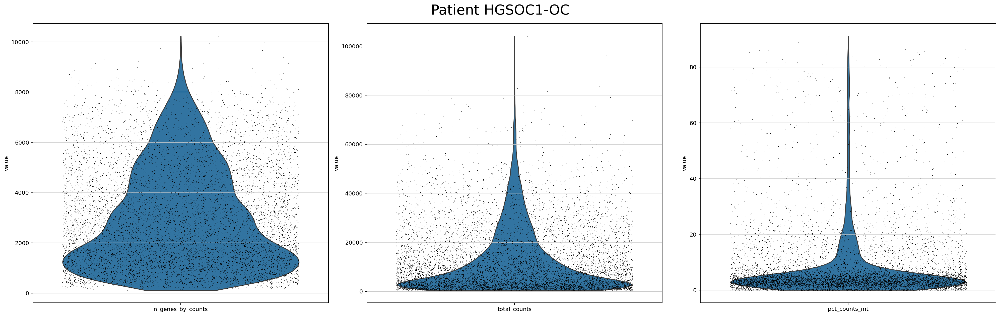

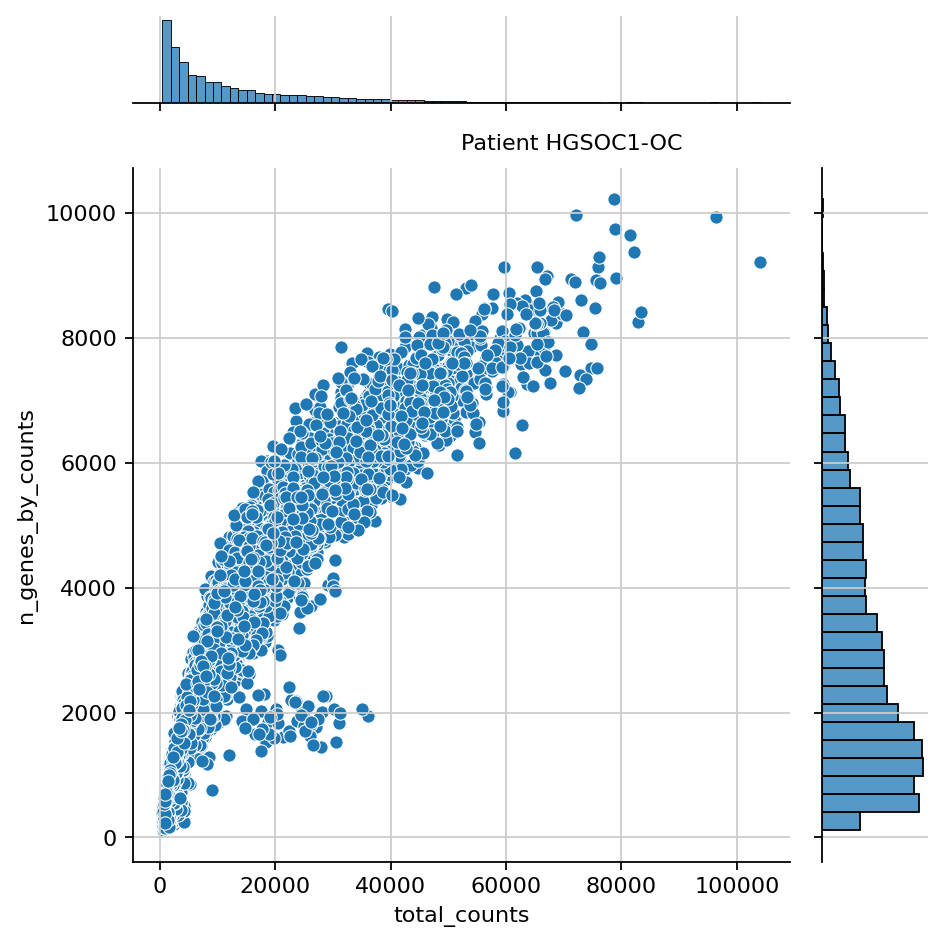

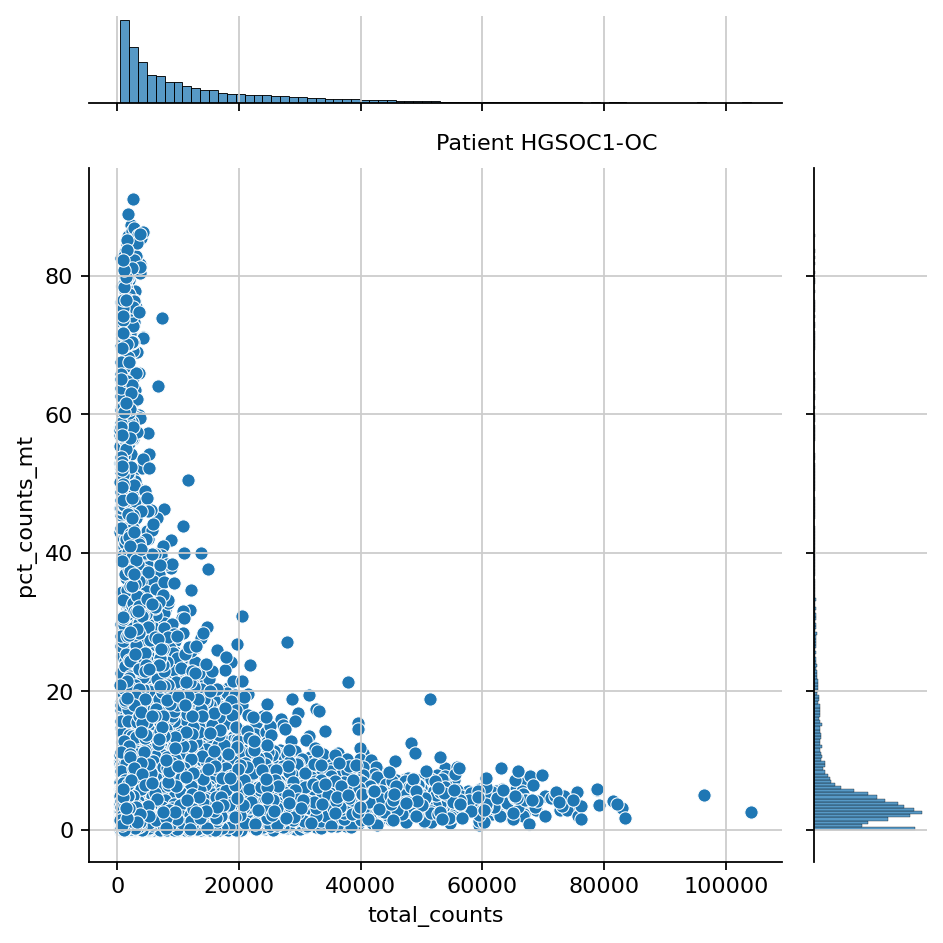

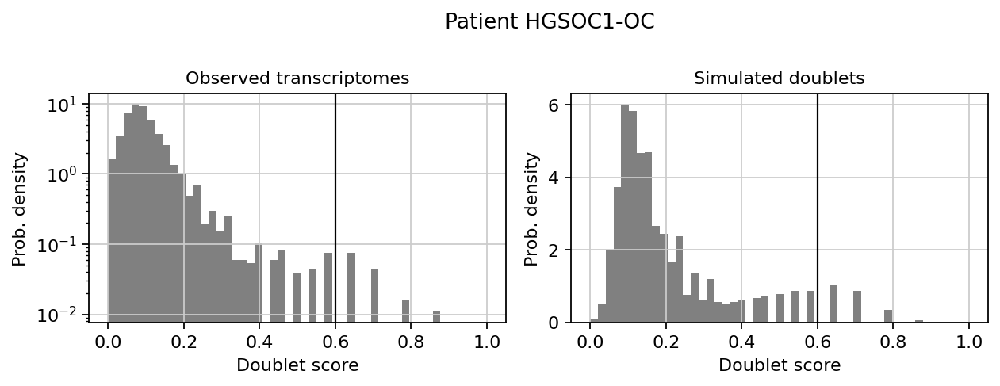

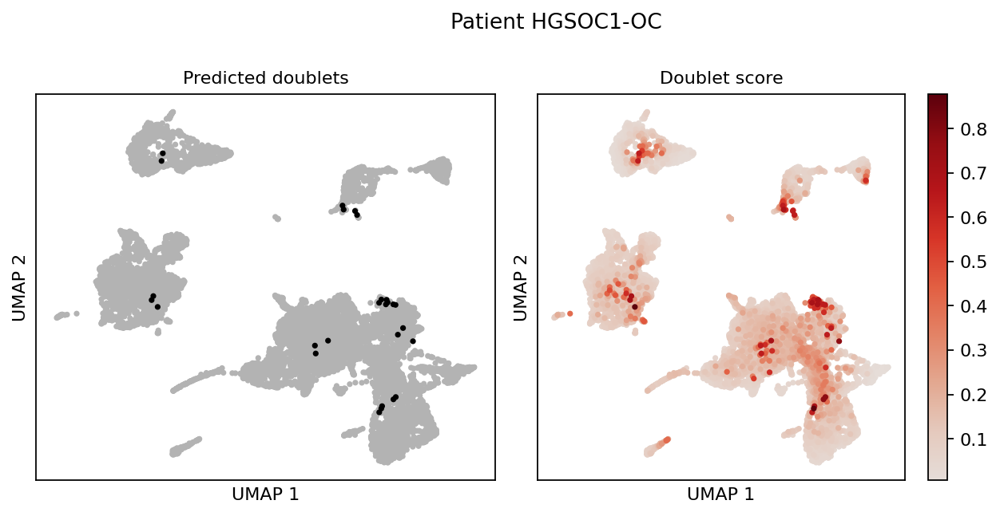

...

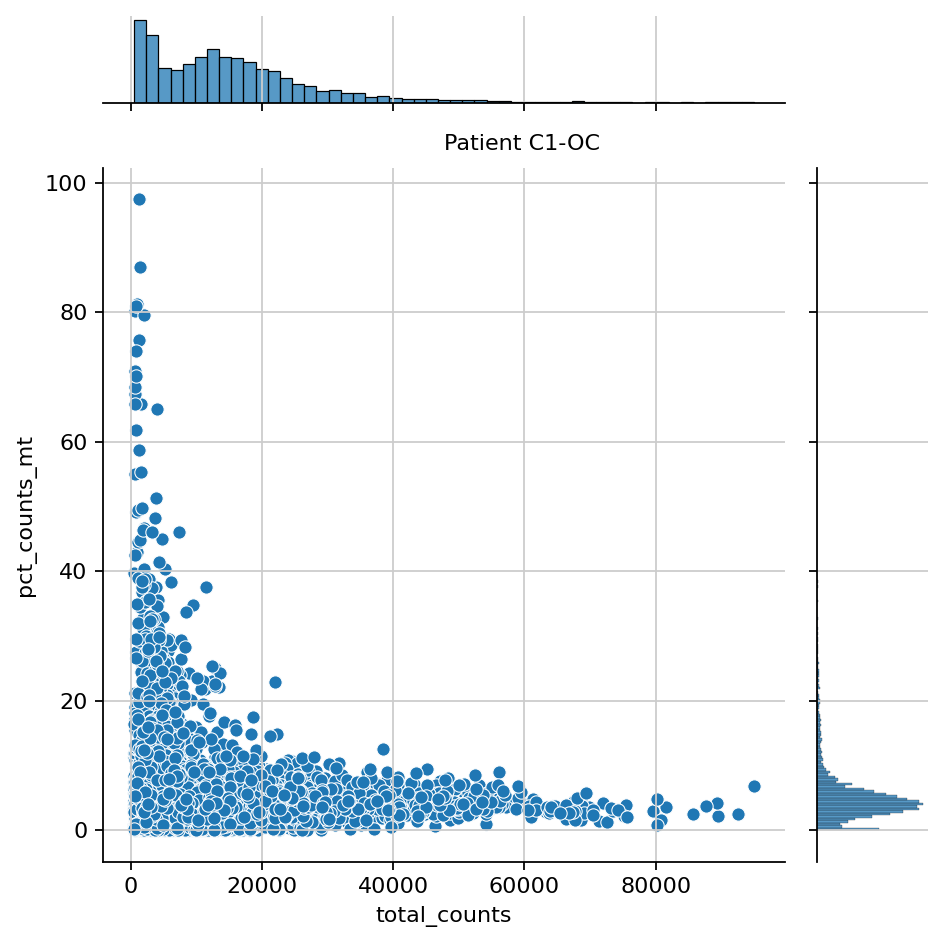

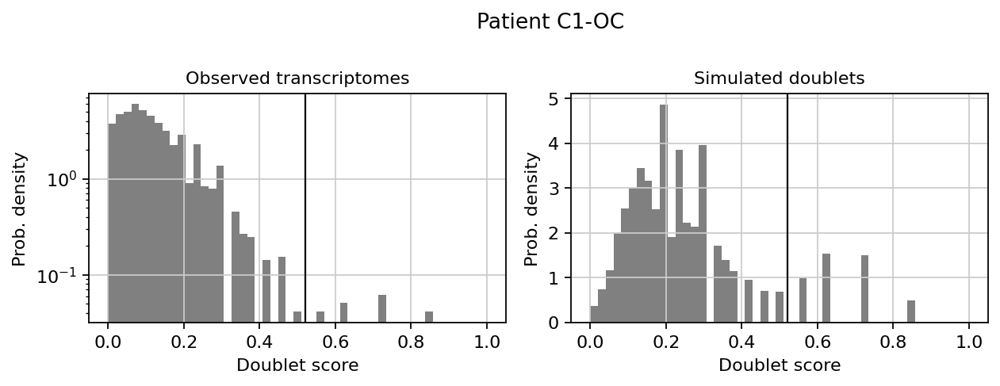

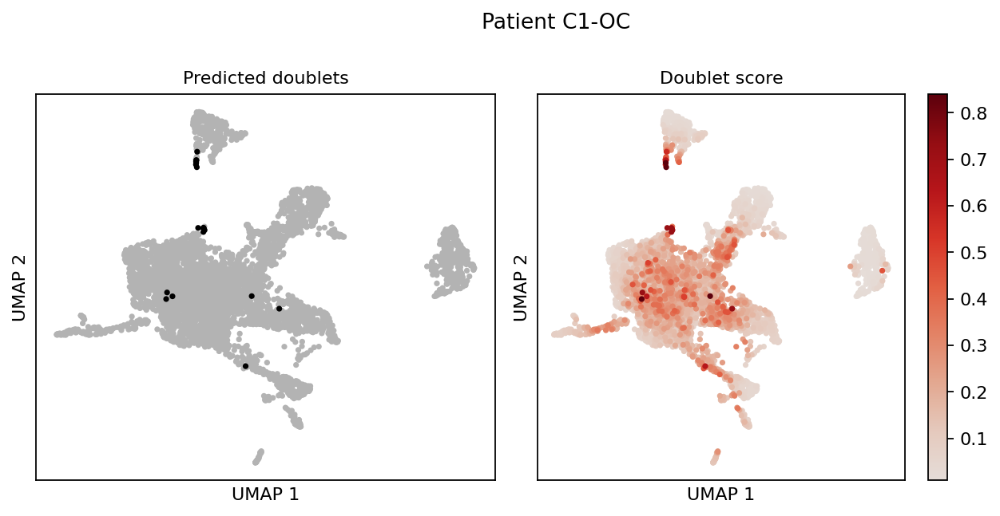

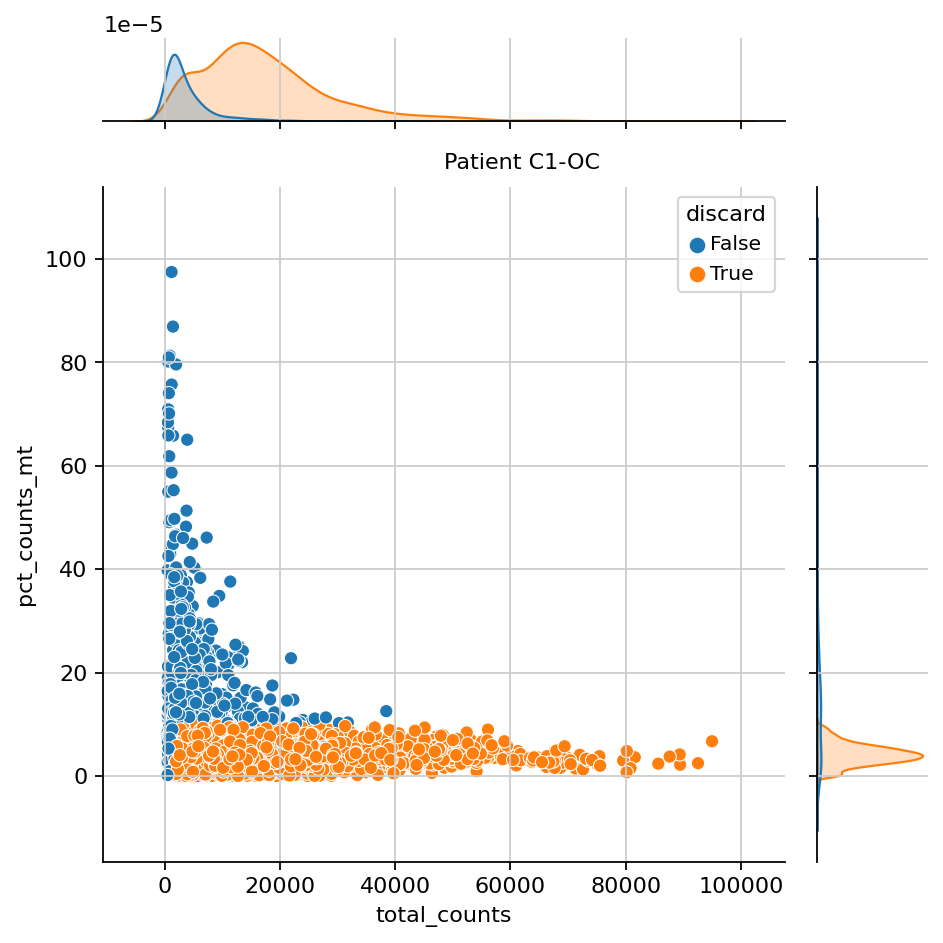

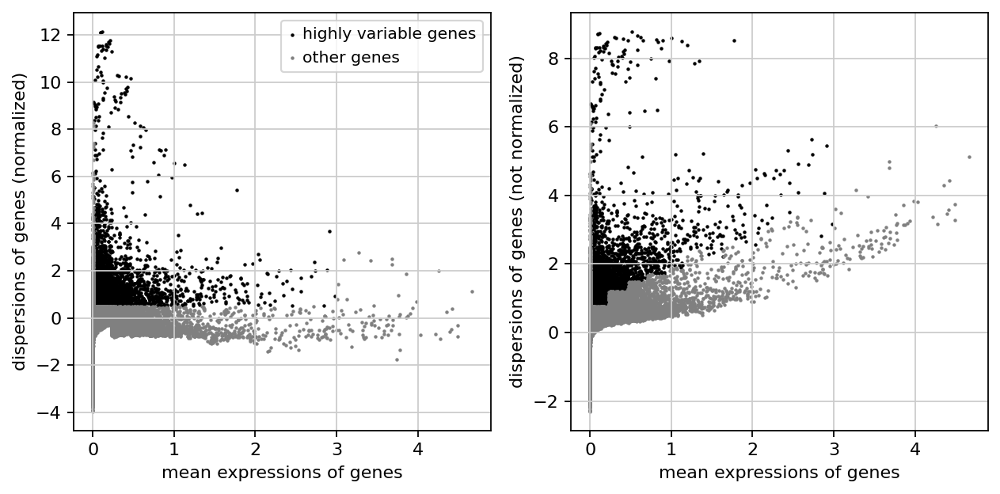

In [5]:
    data = {'HGSOC1-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371754',
            'HGSOC2-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371758',
            'HGSOC3-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371762',
            'HGSOC4-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371767',
            'HGSOC5-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371771',
            
            'HGSOC6-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371773',
            'HGSOC7-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371778',
            'UOC1-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371780',
            'ECO1-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371781',
            'HGSOC8-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371786',
            
            'HGSOC9-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371788',
            'HGSOC10-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371790',
            'C1-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371792',
           } 
    # Key: Sample name; Item: matrix directory or [RNA mtx, tcr csv]
    sample = None # sample name list
    
    matrix = None # matrix directory list (match with sample names)
    rna = True # whether to include RNA analysis
    tcr = False # whether to include TCR analysis
    tcr_data = None # TCR file list: filtered_contig_annotation.csv
    results_file = '/home/zengzw/HRA002184_final/count/Tumor' # self-defined
    exp_type:str = "Control" # self-defined
    marker = marker # self-defined
    cluster_method = "louvain" # leiden or louvain (Louvain is recommended)
    min_cell = 2

    # check input
    file_dic = {}
    if rna == True:
        if (data != None):
            sample = [i for i in data.keys()]
            matrix = [i if isinstance(i,str) else i for i in data.values()]
        if (tcr == False) and (len(sample) == len(matrix)):
            file_dic = dict(zip(sample, matrix))
        elif (tcr == True) and (tcr_data == None):
            if len(sample) != len(matrix):
                raise ValueError("Please inspect your input length.")
            if isinstance(matrix[0], str):
                raise ValueError("Please inspect your input length.")
            else:
                file_dic = dict(zip(sample, matrix))
        elif (tcr == True) and (tcr_data != None):
            if (len(sample) == len(matrix)) and (len(matrix) == len(tcr_data)):
                file_dic = dict(zip(sample, list(zip(matrix, tcr_data))))
            else:
                raise ValueError("Please inspect your input length.")
        else:
            raise ValueError("Please inspect your input data.")
    else:
        raise ValueError("Please inspect your input parameters.")
    # Create output file "./figures"
    stat = {}
    adata_dic = []
    adata_out = []
    
    results_file = os.path.join(results_file, "figures")
    
    
    if os.path.exists(results_file) == False:
        os.mkdir(results_file)

    # Read data
    if rna == True:
        for i in file_dic.keys():
            figid = 1
            patient_id = i
            sc.set_figure_params(fontsize=10)
            print(f'Read:{file_dic[i]}')
            adata = sc.read_10x_mtx(
                path = file_dic[i], var_names = 'gene_symbols', make_unique = True
                )
            adata.var_names_make_unique()
            adata.raw = adata
            if tcr == True:
                vdj = ir.io.read_10x_vdj(file_dic[i][1])
                ir.pp.merge_with_ir(adata, vdj)
            
            # Quality control
            adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
            sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

            # Fig 1. Three violin plots
            fig, axes = plt.subplots(1,3, figsize = (25,8))
            plt.suptitle("Patient " + patient_id, verticalalignment = 'top', horizontalalignment = 'center', fontsize=25)
            sc.pl.violin(adata, 'n_genes_by_counts', jitter=0.4, show=False, ax=axes[0])
            sc.pl.violin(adata, 'total_counts', jitter=0.4, show=False, ax=axes[1])
            sc.pl.violin(adata, 'pct_counts_mt', jitter=0.4, show=False, ax=axes[2])
            savefig(results_file, figid, "violin_preQC", exp_type, patients = patient_id)
            figid += 1

            # Fig 2. Total vs genes
            total_vs_genes = sns.jointplot(
                data=adata.obs,
                x="total_counts",
                y="n_genes_by_counts",
                kind="scatter",
                palette="blue"
            )
            plt.title("Patient " + patient_id, verticalalignment = 'bottom', horizontalalignment = 'left')
            savefig(results_file, figid, "total_vs_genes", exp_type, patients = patient_id)
            figid += 1

            # Fig 3. Total vs mito.percentage
            total_vs_mtcounts = sns.jointplot(
                data=adata.obs,
                x="total_counts",
                y="pct_counts_mt",
                kind="scatter",
                palette="blue"
            )
            plt.title("Patient " + patient_id, verticalalignment = 'bottom', horizontalalignment = 'left')
            savefig(results_file, figid, "total_vs_mitocounts", exp_type, patients = patient_id)
            figid += 1
            
            # Doublet
            counts_matrix = adata.X
            scrub = scr.Scrublet(counts_matrix, expected_doublet_rate=0.1, sim_doublet_ratio=3)
            doublet_scores, predicted_doublets = scrub.scrub_doublets(n_prin_comps=50)

            # Fig4: Doublet his
            scrub.plot_histogram()
            plt.suptitle("Patient " + patient_id, y = 0.999, x=0.55)
            savefig(results_file, figid, "doublet_his", exp_type, patients = patient_id)
            figid += 1
            
            # Fig5: Doublet UMAP
            scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.3))
            scrub.plot_embedding('UMAP', order_points=True)
            plt.suptitle("Patient " + patient_id, y = 0.999, x=0.55)
            savefig(results_file, figid, "doublet_umap", exp_type, patients = patient_id)
            figid += 1
                
            total_counts= (adata.obs.total_counts >= 2000) & (adata.obs.total_counts <= 100000)
            mt_outlier = (adata.obs.pct_counts_mt <= 10)
            doublets = (predicted_doublets==False)

            stat[i] = {
                "max_total_counts": max(adata.obs["total_counts"]), "min_total_counts": min(adata.obs["total_counts"]),
                "mean_total_counts": np.mean(adata.obs["total_counts"]), "medium_total_counts": np.median(adata.obs["total_counts"]),
                "max_features": max(adata.obs["n_genes_by_counts"]), "min_features": min(adata.obs["n_genes_by_counts"]),
                "mean_features": np.mean(adata.obs["n_genes_by_counts"]), "medium_features": np.median(adata.obs["n_genes_by_counts"]),
                "max_mito_counts": max(adata.obs["total_counts_mt"]), "min_mito_counts": min(adata.obs["total_counts_mt"]),
                "mean_mito_counts": np.mean(adata.obs["total_counts_mt"]), "medium_mito_counts": np.median(adata.obs["total_counts_mt"]),
                "max_mito_pct": max(adata.obs["pct_counts_mt"]), "min_mito_pct": min(adata.obs["pct_counts_mt"]),
                "mean_mito_pct": np.mean(adata.obs["pct_counts_mt"]), "medium_mito_pct": np.median(adata.obs["pct_counts_mt"]),
                "cell_number": len(adata.obs["total_counts"]), "gene_number": len(adata.var["gene_ids"]),
                "total_counts_less_than_2e3": sum(adata.obs.total_counts < 2000),
                "total_counts_more_than_1e5": sum(adata.obs.total_counts > 100000),
                "mito_outlier": len(adata.obs["total_counts"]) - np.sum(non_isoutlier(adata.obs.pct_counts_mt)[0]),
                "doublets": np.sum(predicted_doublets), "cell_number_afterQC": sum(total_counts & mt_outlier & doublets)
            }

            adata.obs["discard"] = total_counts & mt_outlier & doublets

            # Fig 6 Total vs mito.percentage
            total_vs_mtcounts = sns.jointplot(
                data=adata.obs,
                x="total_counts",
                y="pct_counts_mt",
                kind="scatter",
                hue=adata.obs.discard
            )
            plt.title("Patient " + patient_id, verticalalignment = 'bottom', horizontalalignment = 'left')
            savefig(results_file, figid, "total_vs_mitocounts_afterQC", exp_type, patients = patient_id)
            figid += 1
            
            # After QC
            adata = adata[adata.obs.discard, :]
            stat[i]["mean_total_counts_afterQC"] = np.mean(adata.obs["total_counts"])
            stat[i]["medium_total_counts_afterQC"] = np.median(adata.obs["total_counts"])
            stat[i]["mean_mito_pct_afterQC"] = np.mean(adata.obs["pct_counts_mt"])
            stat[i]["medium_mito_pct_afterQC"] = np.median(adata.obs["pct_counts_mt"])

            # Normalization
            sc.pp.normalize_total(adata, target_sum=1e4, key_added=True)
            # Log_transform
            sc.pp.log1p(adata)

            adata_dic.append(adata)
            
        if len(sample) > 1:
            # concatenate adatas
            adata_all = sc.AnnData.concatenate(*adata_dic, join="inner", batch_key="batch", batch_categories=sample)
            adata_all.raw = adata_all
        else:
            adata_all = adata
            adata_all.obs['batch'] = sample[0]
            adata_all.obs.batch = sample[0]
        adata_all.obs.rename(columns={True: 'True'}, inplace=True)

        # Feature selection
        sc.pp.highly_variable_genes(adata_all, min_mean=0.0125, max_mean=3, min_disp=0.5)
        # Fig 7: Highly_variable genes
        sc.pl.highly_variable_genes(adata_all, show=False)
        savefig(results_file, figid, "filter_genes_dispersion", exp_type)
        figid += 1

        # Append import markers back
        marker_list = [m for n in marker.values() for m in n]
        for j in marker_list:
            adata_all.var.highly_variable[j] = True

        stat_data = DataFrame(stat)
        stat_data["selected_features"] = sum(adata_all.var.highly_variable)
        stat_data.to_excel(os.path.join(results_file, exp_type + "_data_statistics.xlsx"), index=True)

        adata_all = adata_all[:, adata_all.var.highly_variable]


In [6]:
    adata_all.write_h5ad(results_file + '/clustering_cached.h5ad')
    adata_all.file.close()  # 关闭备份文件

In [7]:
len(sample)

13

In [8]:
adata_all.file.close()

In [8]:
    results_file = '/home/zengzw/HRA002184_final/count/Tumor/figures' # self-defined
    data = {'HGSOC1-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371754',
            'HGSOC2-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371758',
            'HGSOC3-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371762',
            'HGSOC4-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371767',
            'HGSOC5-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371771',
            
            'HGSOC6-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371773',
            'HGSOC7-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371778',
            'UOC1-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371780',
            'ECO1-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371781',
            'HGSOC8-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371786',
            
            'HGSOC9-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371788',
            'HGSOC10-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371790',
            'C1-OC':'/home/zengzw/20240418_data/HRA002184_new/HRS371792',
           } 
    # Key: Sample name; Item: matrix directory or [RNA mtx, tcr csv]
    sample = list(data.keys())

2024-04-19 10:26:41,464 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-04-19 11:50:08,291 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-04-19 11:50:09,583 - harmonypy - INFO - Iteration 1 of 1
2024-04-19 12:06:50,249 - harmonypy - INFO - Stopped before convergence


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:18)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:48)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:07:45)
running Leiden clustering
    finished: found 45 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:01:09)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 38 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:29)


NameError: name 'cluster_method' is not defined

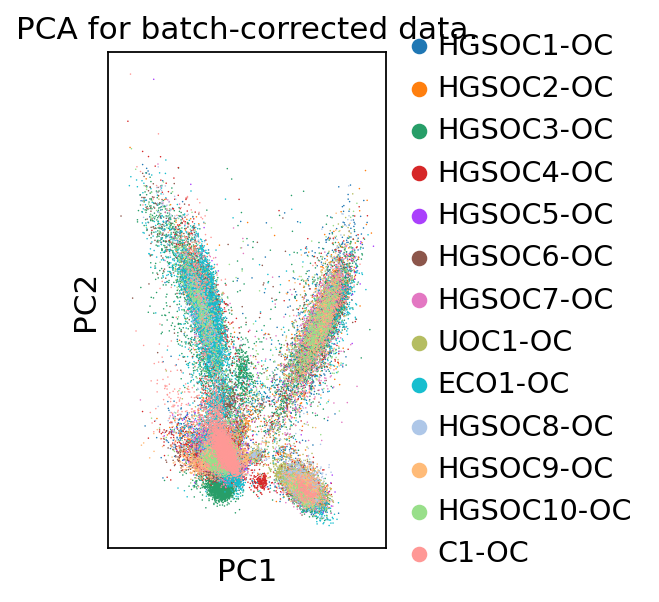

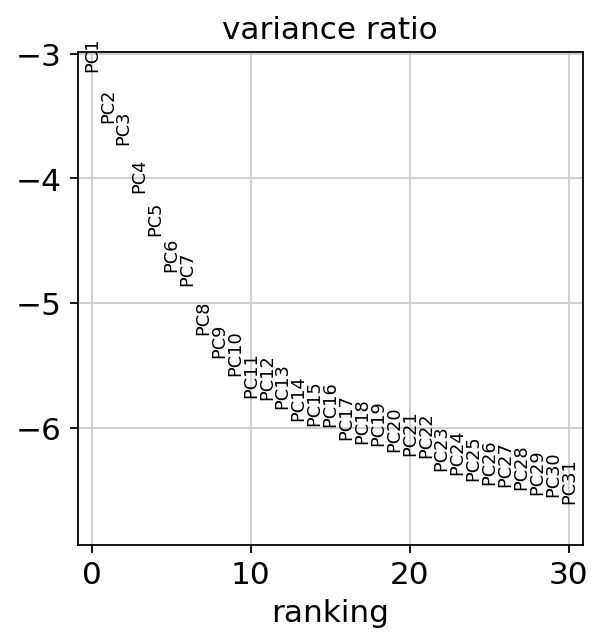

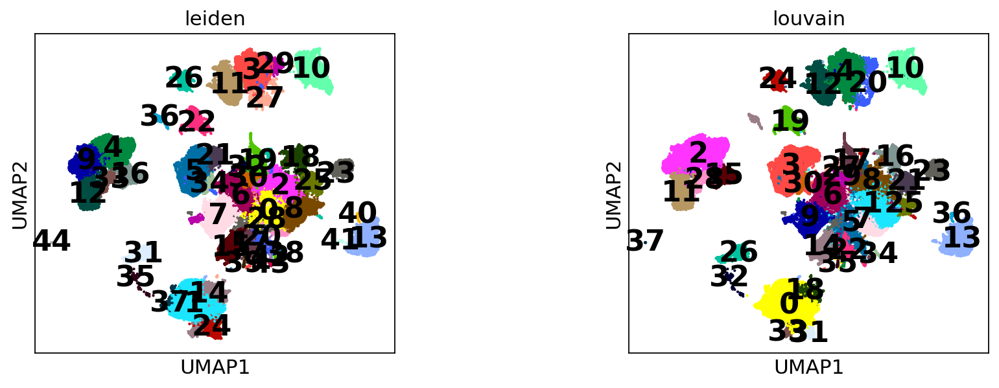

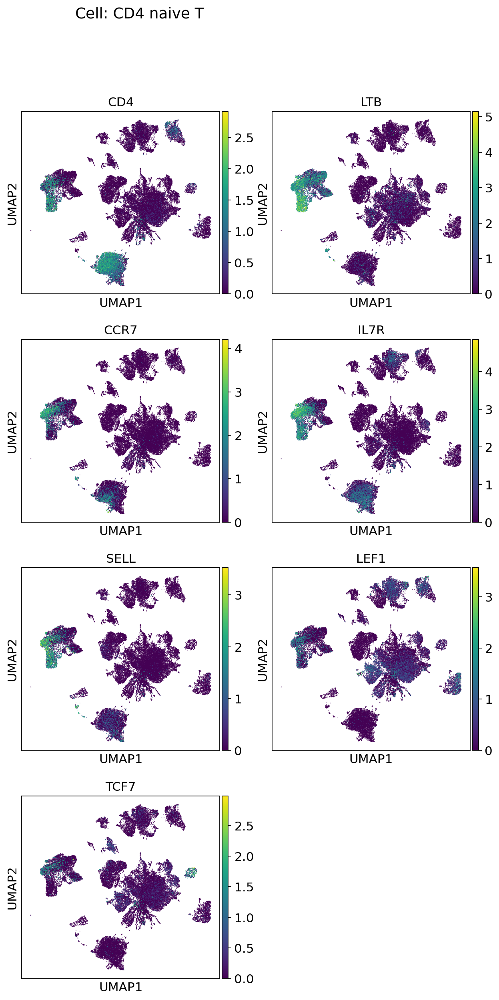

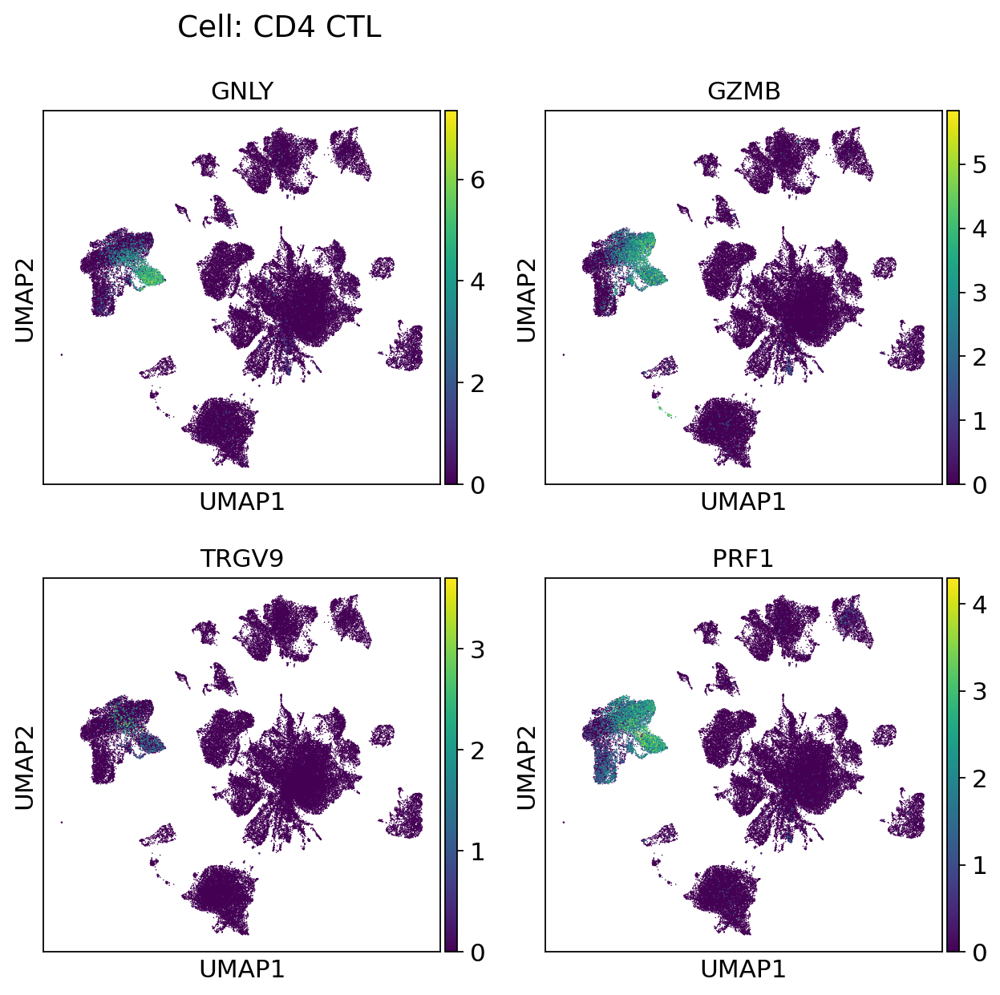

...

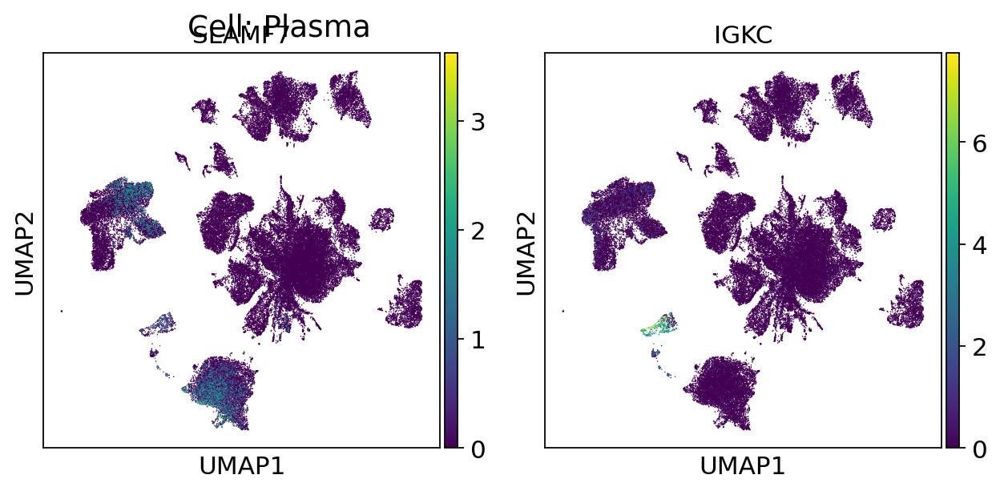

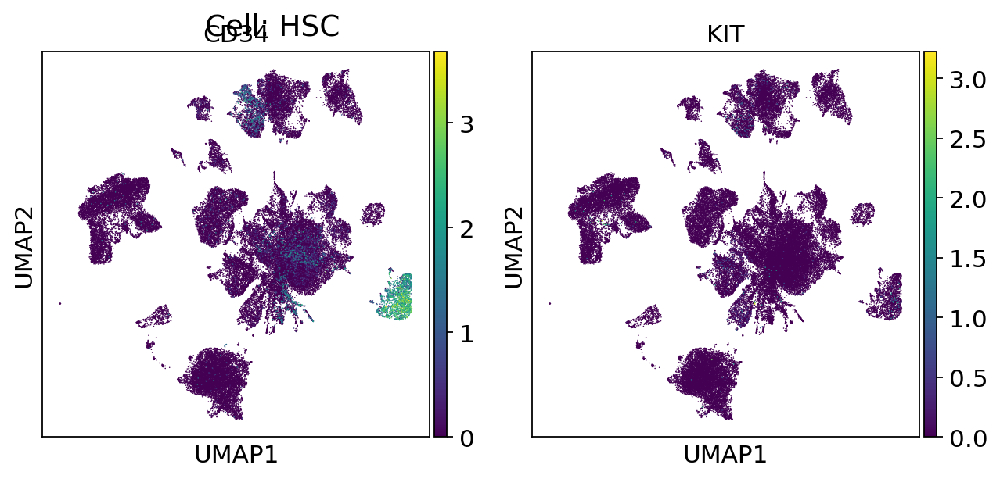

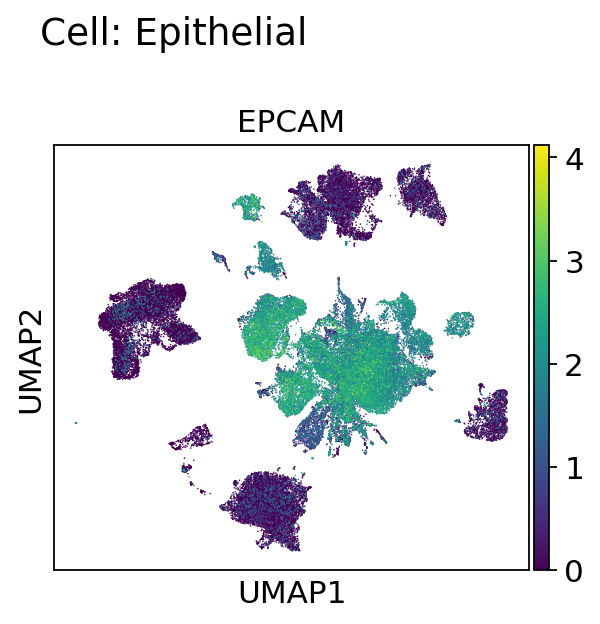

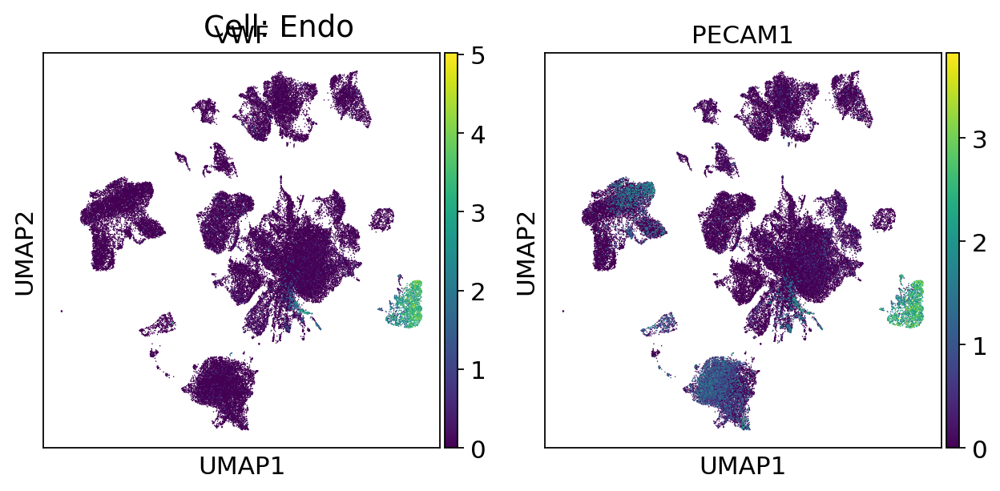

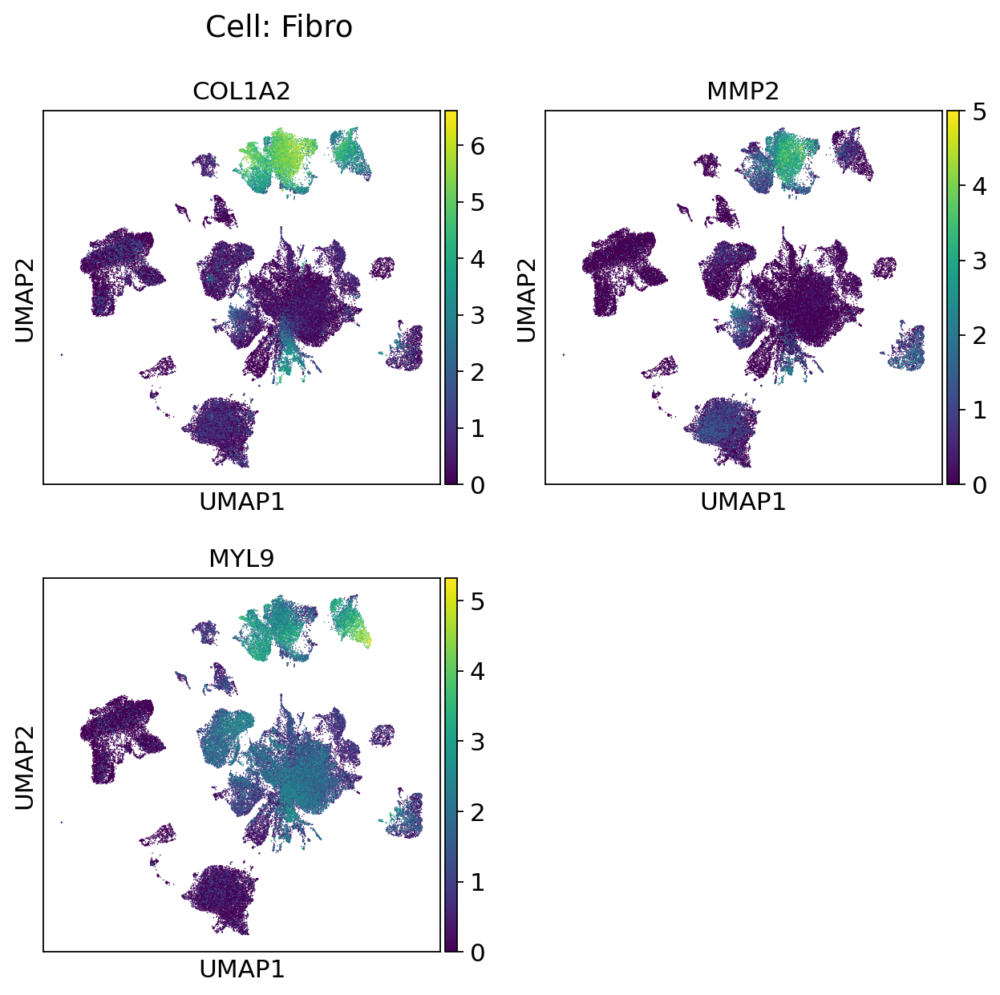

In [3]:
        results_file = '/home/zengzw/HRA002184_final/count/Tumor' # self-defined
        adata_all = sc.read_h5ad(results_file + '/figures/clustering_cached.h5ad')
        exp_type = "Control" # self-defined
            
        # batch correction by harmonypy
        ho = hm.run_harmony(sp.sparse.csr_matrix(adata_all.X).toarray(), adata_all.obs, ["batch"], max_iter_harmony=1)
        adata_ho = adata_all
        adata_ho.raw = adata_ho
        adata_ho.X = ho.Z_corr.T

        sc.pp.scale(adata_ho)

        # PCA
        sc.tl.pca(adata_ho, n_comps=50, svd_solver='arpack')
        # Fig 8: PCA colored by batch
        figid = 8
        sc.pl.pca(adata_ho, title="PCA for batch-corrected data.", color='batch', return_fig=True, show=False)
        savefig(results_file, figid, "doublet_his", exp_type)
        figid += 1
        # Fig 9: PCA variance ratio
        sc.pl.pca_variance_ratio(adata_ho, log=True, show=False)
        savefig(results_file, figid, "PCA_variance_ratio", exp_type)
        figid += 1

        # Graph construction
        sc.pp.neighbors(adata_ho, n_neighbors=10, n_pcs=50)
        # UMAP
        sc.tl.umap(adata_ho, maxiter=1000)
        # Cluster leiden
        sc.tl.leiden(adata_ho)
        # Cluster louvain
        sc.tl.louvain(adata_ho)
        # Fig 10: UMAP --- Leiden & Louvain
        sc.pl.umap(adata_ho, color=['leiden', 'louvain'], legend_fontsize='x-large', size=14, legend_loc='on data', wspace=0.5, show=False, return_fig=True)
        savefig(results_file, figid, "UMAP", exp_type)
        figid += 1

        # Fig 11: marker gene plot
        for j in marker.keys():
            sc.pl.umap(adata_ho, color=marker[j], legend_fontsize="x-small", wspace=0.15, use_raw=True, ncols=2, show=False, return_fig=True)
            plt.suptitle("Cell: " + j, x=0.3, y=0.98)
            savefig(results_file, figid, "geneEx_" + j, exp_type)
        figid += 1

        # Fig 12: marker gene violin (louvain)
        for j in marker.keys():
            violin_group(adata_ho, marker[j], cluster_method)
            plt.suptitle("Cell: " + j, x=0.3, y=0.98)
            savefig(results_file, figid, "violinP_" + j, exp_type)
        figid += 1

        # Fig 13: marker gene dotplot (louvain)
        for j in marker.keys():
            sc.pl.dotplot(adata_ho, marker[j], groupby=cluster_method, use_raw=True, title="Cell: "+j, show=False)
            savefig(results_file, figid, "dotP_"+j, exp_type)
        figid += 1

        # Fig 14: heatmap
        sc.set_figure_params(fontsize=4)
        sc.pl.heatmap(
            adata_ho, var_names=marker_list, use_raw=True, 
            groupby=cluster_method, figsize=(9,6.3), 
            swap_axes=True, vmin=0, vmax=12,
            show_gene_labels=True, show=False, cmap='coolwarm'
        )
        savefig(results_file, figid, "heatmap", exp_type)
        figid += 1

        # Fig 15：stack violin
        sc.set_figure_params(fontsize=10)
        sc.pl.stacked_violin(adata_ho, marker_list, use_raw=True, groupby=cluster_method, rotation=45, swap_axes=True, show=False)
        savefig(results_file, figid, "stacked_violin", exp_type)
        figid += 1

        # Fig 16: trackplot
        sc.pl.tracksplot(adata_ho, groupby=cluster_method, var_names=marker_list, use_raw=True, var_group_rotation=45, show=False)
        savefig(results_file, figid, "trackplot", exp_type)
        figid += 1

        # Save adata
        if tcr == False:
            obs_raw = adata_ho.obs.cKolumns.values
            if (True in obs_raw):
                adata_ho.obs = adata_ho.obs[obs_raw[np.where(obs_raw != True)]]
            adata_ho.filename = os.path.join(results_file, exp_type + ".h5ad")
            print(adata_ho.isbacked)
            adata_out = adata_ho
        else:
            adata = adata_ho
            adata_out = tcr_analysis(results_file, figid, exp_type, adata, patient="ALL", rna=True, min_cell=min_cell)
    
    adata_out.write_h5ad(results_file + '/clustering.h5ad')
    adata_out.file.close()  # 关闭备份文件

NameError: name 'marker_list' is not defined

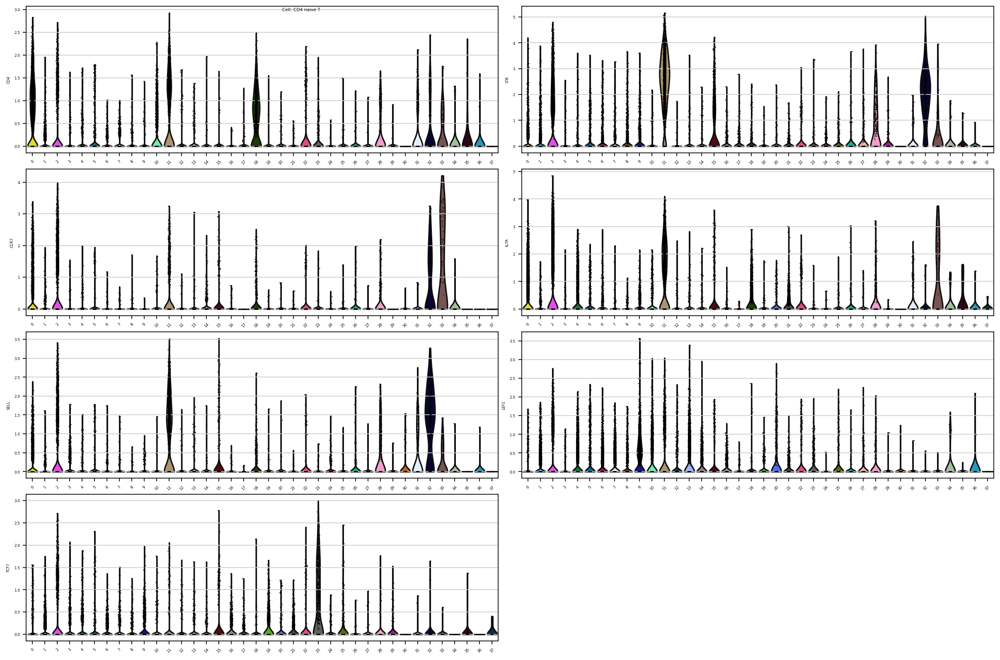

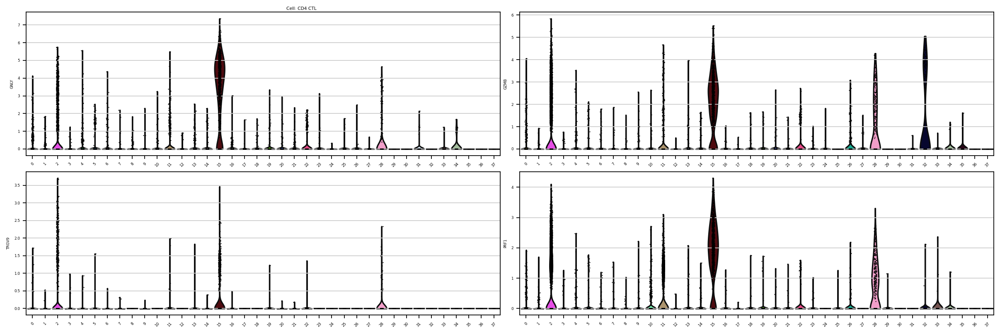

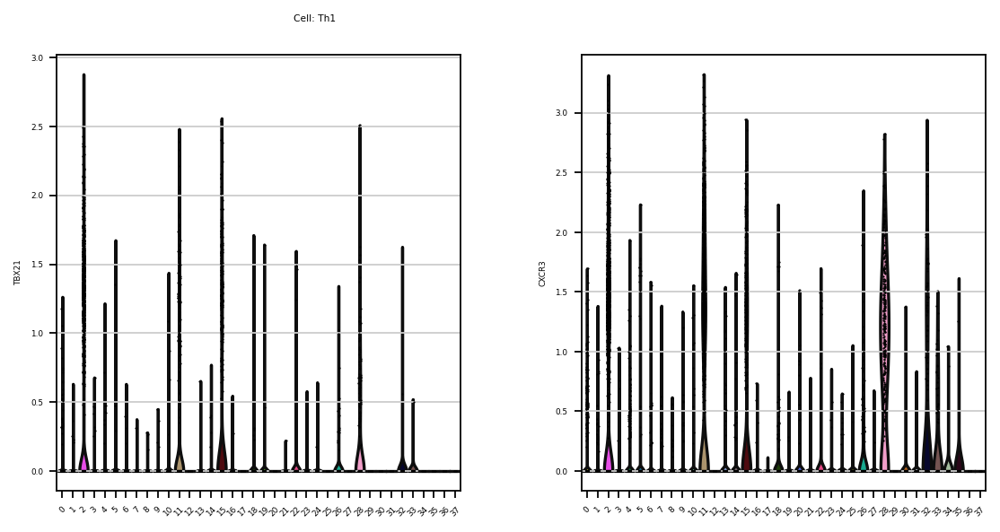

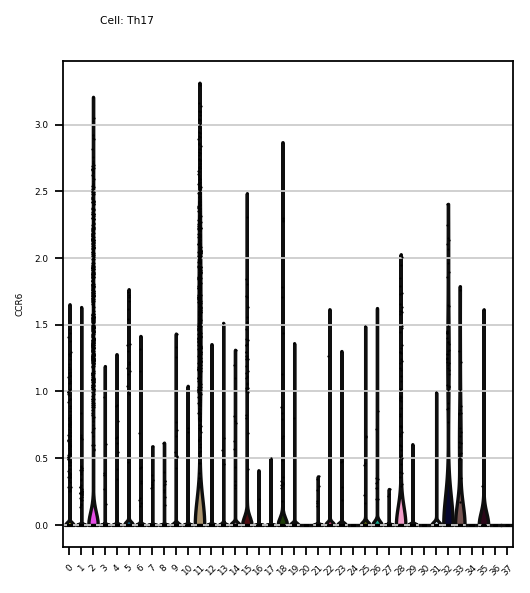

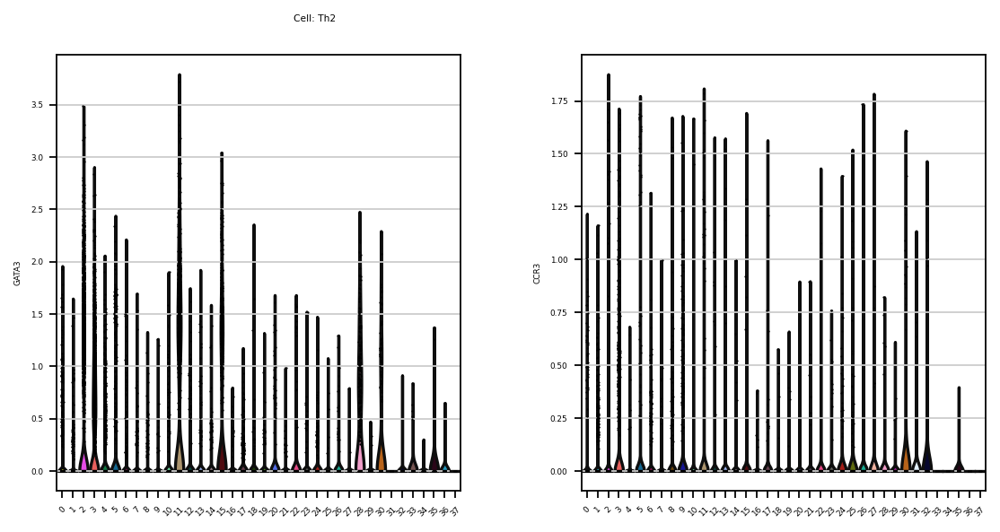

...

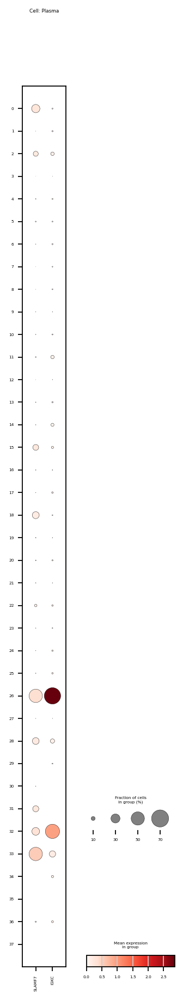

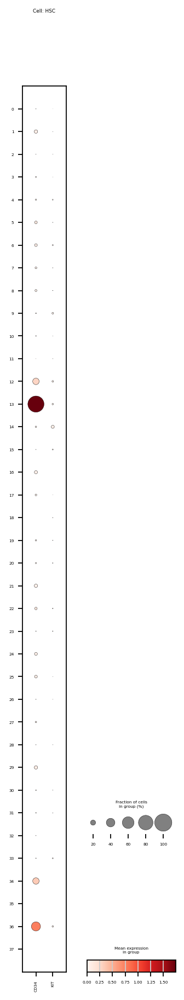

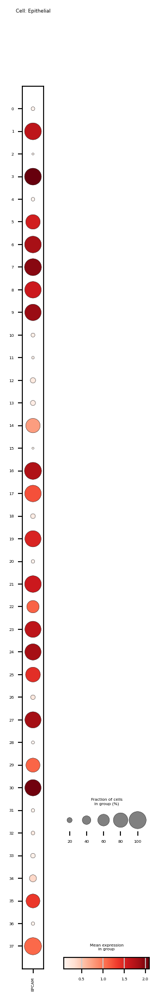

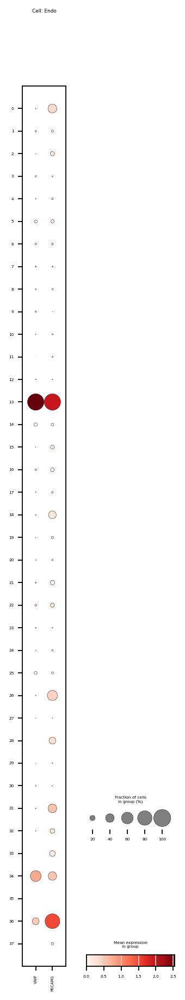

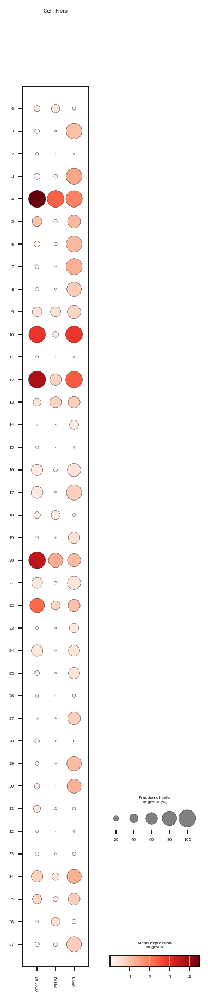

In [6]:
        marker = marker # self-defined
        cluster_method = "louvain" # leiden or louvain (Louvain is recommended)
        min_cell = 2
        # Fig 12: marker gene violin (louvain)
        for j in marker.keys():
            violin_group(adata_ho, marker[j], cluster_method)
            plt.suptitle("Cell: " + j, x=0.3, y=0.98)
            savefig(results_file, figid, "violinP_" + j, exp_type)
        figid += 1

        # Fig 13: marker gene dotplot (louvain)
        for j in marker.keys():
            sc.pl.dotplot(adata_ho, marker[j], groupby=cluster_method, use_raw=True, title="Cell: "+j, show=False)
            savefig(results_file, figid, "dotP_"+j, exp_type)
        figid += 1


NameError: name 'tcr' is not defined

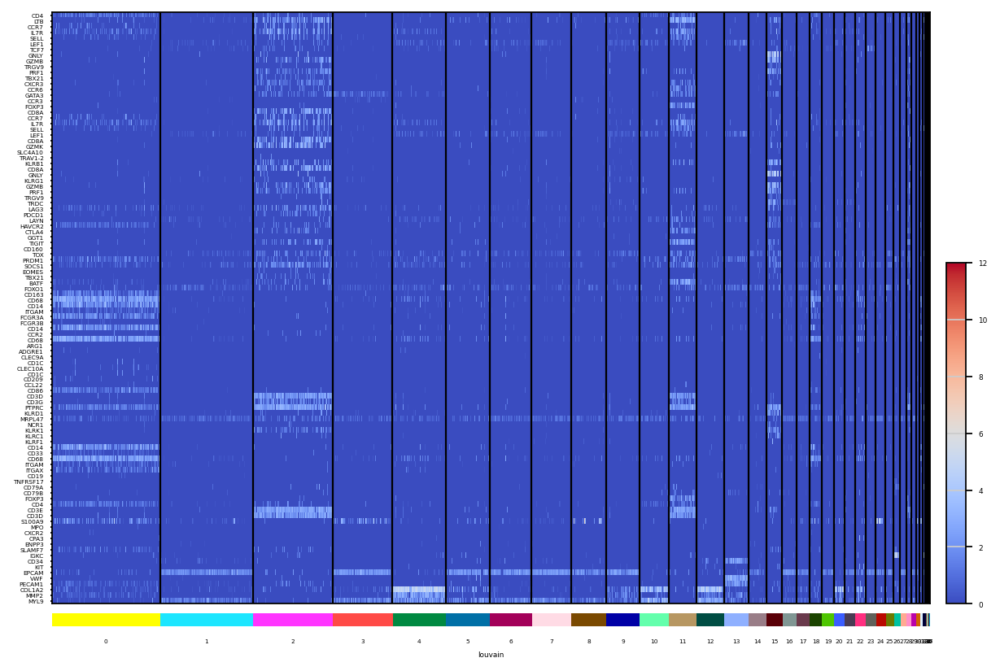

In [ ]:

        # Fig 14: heatmap
        marker_list = [m for n in marker.values() for m in n]
        sc.set_figure_params(fontsize=4)
        sc.pl.heatmap(
            adata_ho, var_names=marker_list, use_raw=True, 
            groupby=cluster_method, figsize=(9,6.3), 
            swap_axes=True, vmin=0, vmax=12,
            show_gene_labels=True, show=False, cmap='coolwarm'
        )
        savefig(results_file, figid, "heatmap", exp_type)
        figid += 1

        # Fig 15：stack violin
        sc.set_figure_params(fontsize=10)
        sc.pl.stacked_violin(adata_ho, marker_list, use_raw=True, groupby=cluster_method, rotation=45, swap_axes=True, show=False)
        savefig(results_file, figid, "stacked_violin", exp_type)
        figid += 1

        # Fig 16: trackplot
        sc.pl.tracksplot(adata_ho, groupby=cluster_method, var_names=marker_list, use_raw=True, var_group_rotation=45, show=False)
        savefig(results_file, figid, "trackplot", exp_type)
        figid += 1

        # Save adata
        if tcr == False:
            obs_raw = adata_ho.obs.cKolumns.values
            if (True in obs_raw):
                adata_ho.obs = adata_ho.obs[obs_raw[np.where(obs_raw != True)]]
            adata_ho.filename = os.path.join(results_file, exp_type + ".h5ad")
            print(adata_ho.isbacked)
            adata_out = adata_ho
        else:
            adata = adata_ho
            adata_out = tcr_analysis(results_file, figid, exp_type, adata, patient="ALL", rna=True, min_cell=min_cell)
    
    adata_out.write_h5ad(results_file + '/clustering.h5ad')
    adata_out.file.close()  # 关闭备份文件

In [13]:
1

1

In [14]:
    adata_out = adata_ho
    
    adata_out.write_h5ad(results_file + '/clustering.h5ad')
    adata_out.file.close()  # 关闭备份文件

In [17]:
import anndata as ad
def Annotate(
    adata,
    annotation:map,
):
    adata_ho.obs['cell_type'] = 'other'
    for key in annotation.keys():
        for cluster in annotation[key]:
            if(adata_ho.obs.loc[adata_ho.obs['louvain'] == str(cluster), 'cell_type'][0] != 'other'):
                print(f'Error: Cluster {cluster} conflict!')
                print(f'Set to "other"')
                adata_ho.obs.loc[adata_ho.obs['louvain'] == str(cluster), 'cell_type'] = 'other'
            else:
                adata_ho.obs.loc[adata_ho.obs['louvain'] == str(cluster), 'cell_type'] = key


In [34]:
adata_ho = sc.read_h5ad(results_file[:-8] + '/clustering.h5ad')

FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = '/home/zengzw/HRA002184_final/cou/clustering.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [21]:
# M-0,18,22,31; T-2,11,28; N-15,28; 26,32,33; E:1,3,4,5,6,7,8,9,16,19,21,23,24,25,27,30,35,37 F-4,10,12,20
annotation = {'Endo':[13,36],
              'Tumor':[1,3,6,7,8,9,16,23,24,27,30],
              'B cell':[26,32,33],
              'Fibro':[4,10,12,20],
              'Macrophage':[0,18,22,31],
              'NK cell':[15,28],
              'T cell':[2,11]
}
Annotate(adata_ho, annotation)

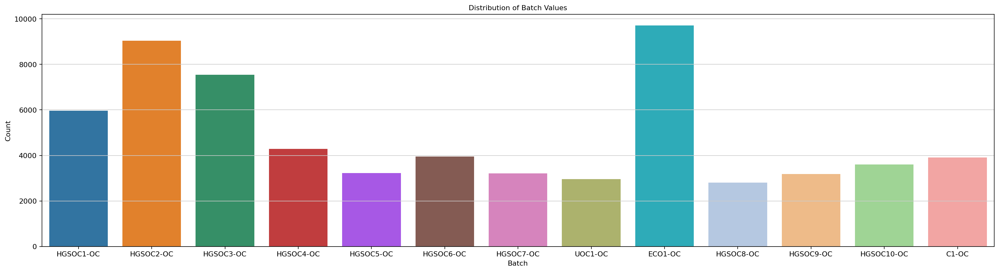

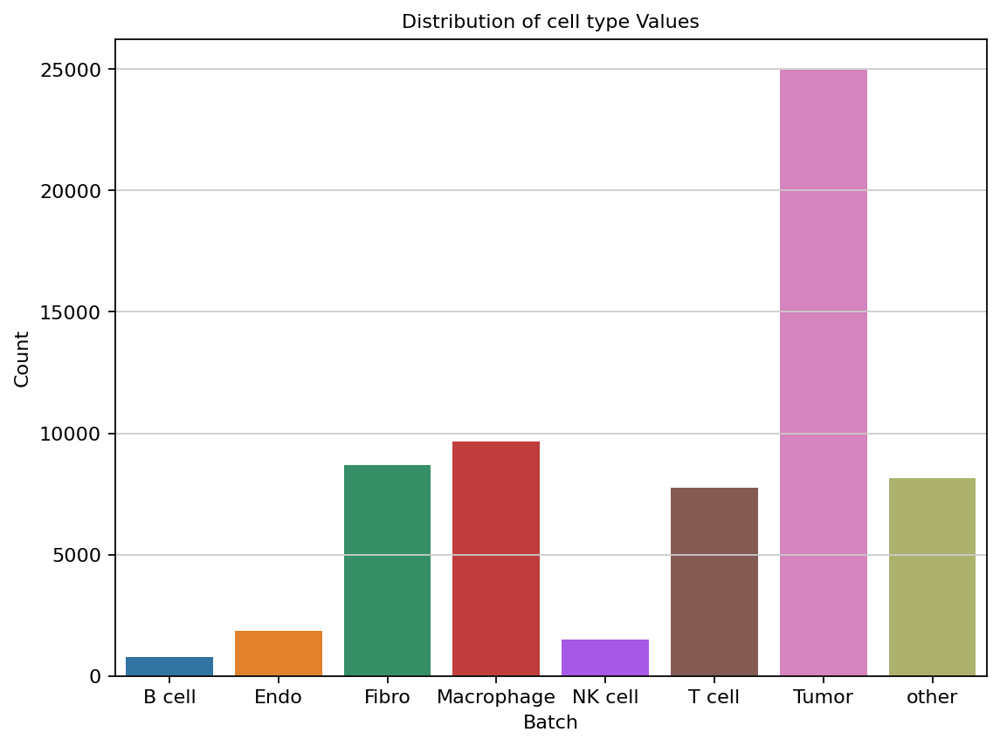

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns

# 假设adata_filtered是筛选后的AnnData对象
# adata_filtered = ...

# 绘制batch列值的分布
plt.figure(figsize=(24, 6))
sns.countplot(x=adata_ho.obs['batch'])
plt.title('Distribution of Batch Values')
plt.xlabel('Batch')
plt.ylabel('Count')
plt.savefig('/home/zengzw/HRA002184_final/count/Tumor/Distribution of Batch Values.png')
plt.show()
# 假设adata_filtered是筛选后的AnnData对象
# adata_filtered = ...

# 绘制batch列值的分布
plt.figure(figsize=(8, 6))
sns.countplot(x=adata_ho.obs['cell_type'])
plt.title('Distribution of cell type Values')
plt.xlabel('Batch')
plt.ylabel('Count')
plt.savefig('/home/zengzw/HRA002184_final/count/Tumor/Distribution of cell type Values.png')
plt.show()

In [27]:
adata_ho.write_h5ad(results_file + '/clustering.h5ad')

AttributeError: Could not find dataset for raw X in file: /home/zengzw/HRA002184_final/count/Tumor/clustering.h5ad.

Above error raised while writing key 'raw' of <class 'h5py._hl.group.Group'> to /

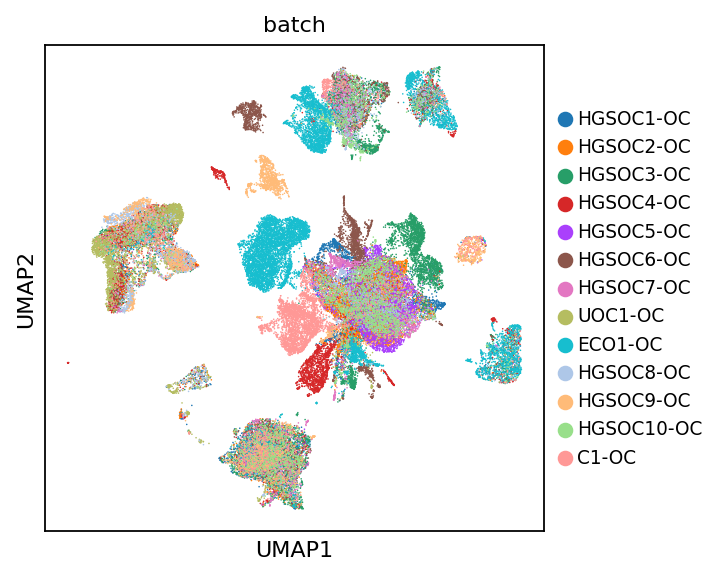

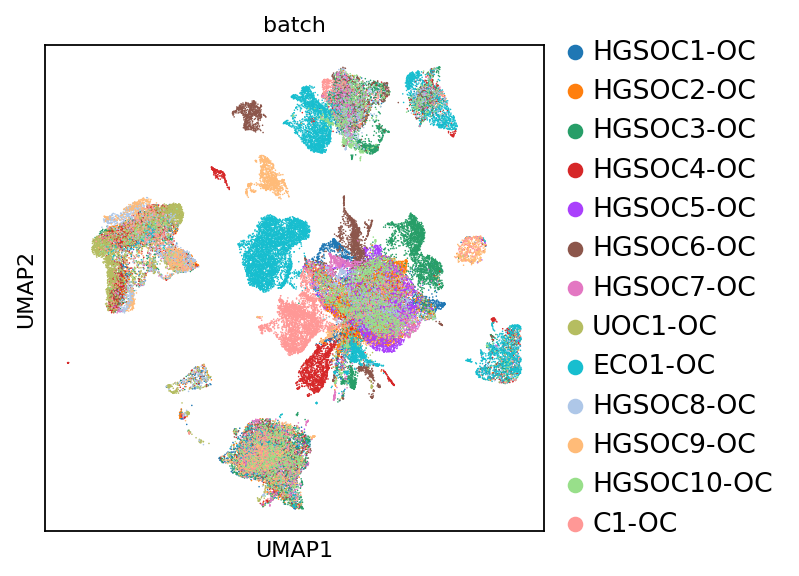

In [15]:
color = [(225,129,44),(54,143,103),(214,132,189),(50,116,161),(192,61,62),(132,91,83)]
normalized_color = []
for item in color:
    normalized_color.append(tuple(x/255 for x in item))
    
sc.pl.umap(adata_ho, color=['batch'], legend_fontsize='small', size=2, legend_loc='right margin', wspace=0.5, show=True, save='.pdf')
sc.pl.umap(adata_ho, color=['batch'], legend_fontsize='large', size=2, legend_loc='right margin', wspace=0.5, show=True, save='.png')

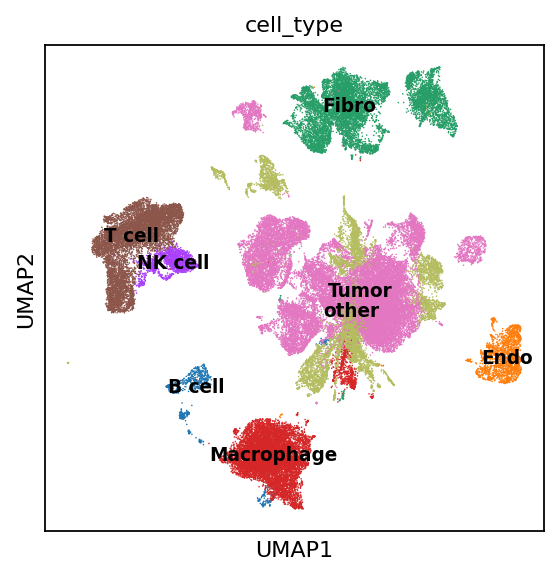

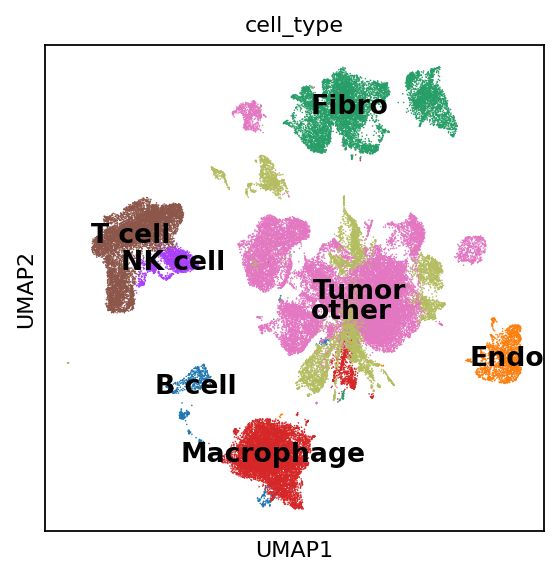

In [28]:
sc.pl.umap(adata_ho, color=['cell_type'], legend_fontsize='small', size=2, legend_loc='on data', wspace=0.5, show=True, save='_annotated.pdf')
sc.pl.umap(adata_ho, color=['cell_type'], legend_fontsize='large', size=2, legend_loc='on data', wspace=0.5, show=True, save='_annotated.png')

In [79]:
adata_all.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,discard,True,batch,leiden,louvain
AAACCTGAGACGCTTT-1-GC02-TIL,1197,2298.0,188.0,8.181027,True,2298.0,GC02-TIL,5,7
AAACCTGAGACTACAA-1-GC02-TIL,2669,6354.0,357.0,5.618508,True,6354.0,GC02-TIL,17,17
AAACCTGAGGGAACGG-1-GC02-TIL,1773,3635.0,140.0,3.851444,True,3635.0,GC02-TIL,17,17
AAACCTGAGGTTCCTA-1-GC02-TIL,1912,4373.0,127.0,2.904185,True,4373.0,GC02-TIL,5,7
AAACCTGAGTCAATAG-1-GC02-TIL,1907,4132.0,146.0,3.533398,True,4132.0,GC02-TIL,23,23
...,...,...,...,...,...,...,...,...,...
TTTGTCATCAAACCAC-1-GC10-TIL,1660,4051.0,115.0,2.838805,True,4051.0,GC10-TIL,1,0
TTTGTCATCAGGTAAA-1-GC10-TIL,2357,5769.0,430.0,7.453631,True,5769.0,GC10-TIL,21,22
TTTGTCATCCAAATGC-1-GC10-TIL,1967,4417.0,98.0,2.218700,True,4417.0,GC10-TIL,1,2
TTTGTCATCCCTTGCA-1-GC10-TIL,1620,3543.0,83.0,2.342648,True,3543.0,GC10-TIL,5,7


In [97]:
adata_ho = sc.read('/home/zengzw/HRA000704_results/count/Tumor/tumor_clustering.h5ad')

In [82]:
adata.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,discard,True,batch
AAACCTGAGACGCTTT-1-GC02-TIL,1197,2298.0,188.0,8.181027,True,2298.0,GC02-TIL
AAACCTGAGACTACAA-1-GC02-TIL,2669,6354.0,357.0,5.618508,True,6354.0,GC02-TIL
AAACCTGAGGGAACGG-1-GC02-TIL,1773,3635.0,140.0,3.851444,True,3635.0,GC02-TIL
AAACCTGAGGTTCCTA-1-GC02-TIL,1912,4373.0,127.0,2.904185,True,4373.0,GC02-TIL
AAACCTGAGTCAATAG-1-GC02-TIL,1907,4132.0,146.0,3.533398,True,4132.0,GC02-TIL
...,...,...,...,...,...,...,...
TTTGTCATCAAACCAC-1-GC10-TIL,1660,4051.0,115.0,2.838805,True,4051.0,GC10-TIL
TTTGTCATCAGGTAAA-1-GC10-TIL,2357,5769.0,430.0,7.453631,True,5769.0,GC10-TIL
TTTGTCATCCAAATGC-1-GC10-TIL,1967,4417.0,98.0,2.218700,True,4417.0,GC10-TIL
TTTGTCATCCCTTGCA-1-GC10-TIL,1620,3543.0,83.0,2.342648,True,3543.0,GC10-TIL


In [33]:
    adata_out.write_h5ad(results_file + '/tumor_clustering.h5ad')
    adata_out.file.close()  # 关闭备份文件

AttributeError: Could not find dataset for raw X in file: /home/zengzw/HRA002184_final/count/Tumor/clustering.h5ad.

Above error raised while writing key 'raw' of <class 'h5py._hl.group.Group'> to /